# Рынок заведений общественного питания Москвы

## Описание проекта

Имеются данные сервиса Яндекс.Карты по заведениям общественного питания Москвы по состоянию на середину 2022 года. Необходимо провести анализ рынка, а также определить потенциальные районы для наиболее эффективного расположения новой кофейни.

**Задача**: Изучить рынок заведений общественного питания г. Москвы, определить характерные особенности, провести детальное исследование кофеен города и предложить наиболее выгодные при имеющихся данных районы для расположения новой кофейни.

**Данные для исследования:** датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

## Открытие данных

Первым делом выгрузим датасет и изучим его. Датасет основан на данных Я.Карт и Я.Бизнеса по состоянию на лето 2022 года.

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
from plotly import graph_objects as go 
from matplotlib import pyplot as plt
from folium import Map, Choropleth
from folium import Map, Marker
from folium.plugins import MarkerCluster


df = pd.read_csv('moscow_places.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Всего в датасете 8406 записей, для всех записей известны наименование, категория, адрес, административный округ Москвы, координаты, рейтинг и значение, указывающее на принадлежность к какой-либо сети.

Есть некоторое количество пропусков в данных о часах работы заведений, эти пропуски, скорее всего, можно будет заполнить часто встречающимся значением часов работы для конкретной категории (в случае если в выборке пропущенных значений будет несколько категорий).

Интересно заметить, что характеристика категорий цен имеет больше пропусков, чем заведения, для которых указана величина среднего счета. Аналогично и с оценкой среднего чека - данных в ней меньше, чем в данных о среднем чеке вообще, соответственно, на основе имеющихся данных можно будет заполнить пропуски.

Количество посадочных мест также имеет пропуски - но и его можно будет заполнить неким значением, наиболее характерным для какой-либо категории.

## Предобработка данных

Начнем с названий заведений, рассмотрев из в разрезе уникальных значений. Есть вероятность, что они могут повторяться по причине наличия различного рода опечаток, ненужных символов или перепутанных букв.

In [2]:
df['name'].value_counts()

Кафе                189
Шоколадница         120
Домино'с Пицца       76
Додо Пицца           74
One Price Coffee     71
                   ... 
Сащя                  1
Мой дом               1
Stardogs              1
Bar Park 15           1
Kebab Time            1
Name: name, Length: 5614, dtype: int64

5614 уникальных значений - пройдет целая вечность в попытках найти опечатки, лишние буквы, либо подмененные английскими русские буквы, имеющие одинаковое начертание. Поэтому предположим, что в этом столбце наименования корректны. При этом мы узнали, что в Москве есть целых 189 заведений, которые называются просто "Кафе". Возможно, то маленькие придорожные кафе на МКАДе, либо одиночные мелкие заведения для быстрого перекуса, либо мелкие кафе в вестибюлях метро.

Теперь проверим уникальные значения в категориях заведений. Ошибки и опечатки могут быть там, да и значений должно быть определенно меньше.

In [3]:
df['category'].value_counts()

кафе               2378
ресторан           2043
кофейня            1413
бар,паб             765
пиццерия            633
быстрое питание     603
столовая            315
булочная            256
Name: category, dtype: int64

Судя по всему, здесь ошибок нет. И есть отдельные категории "кафе" и "кофейня", которые в дальнейшем и будут целевыми группами исследования в задаче.

Проверим, какие округа Москвы встречаются в выборке.

In [4]:
df['district'].value_counts()

Центральный административный округ         2242
Северный административный округ             900
Южный административный округ                892
Северо-Восточный административный округ     891
Западный административный округ             851
Восточный административный округ            798
Юго-Восточный административный округ        714
Юго-Западный административный округ         709
Северо-Западный административный округ      409
Name: district, dtype: int64

Всего 9 округов, нет ТиНАО, что, с одной стороны правильно, поскольку округу только 10 лет, а с другой - еще и логично, поскольку в округе, в основном, множество сёл и деревень, и всего несколько мелких городов (Троицк, Щербинка, Ватутинки, Коммунарка и прочие).

Сразу бросается в глаза то, что большинство заведений сосредоточены в ЦАО, но к этому вопросу мы вернемся позже.

In [5]:
df['hours'].value_counts()

ежедневно, 10:00–22:00                                                  759
ежедневно, круглосуточно                                                730
ежедневно, 11:00–23:00                                                  396
ежедневно, 10:00–23:00                                                  310
ежедневно, 12:00–00:00                                                  254
                                                                       ... 
пн-пт 17:00–03:00; сб,вс 17:00–05:00                                      1
пн,вт 09:00–21:00; ср-пт 09:00–22:00; сб 10:00–22:00; вс 10:00–21:00      1
пн-пт 12:00–01:00                                                         1
пн-пт 10:30–21:30; сб,вс 10:30–22:30                                      1
пн-сб 10:30–21:30                                                         1
Name: hours, Length: 1307, dtype: int64

В часах работы уже интереснее - 1307 уникальных записей, есть заметные лидеры в значениях, а есть и выбивающиеся единичные значения. Тем не менее, пока предположим, что в этих данных нет ошибок.

In [6]:
df['rating'].value_counts()

4.3    1513
4.4    1351
4.2    1041
4.1     785
4.5     623
4.0     499
4.7     440
4.6     422
3.9     252
4.9     243
4.8     215
3.8     188
3.7     147
5.0     105
3.6      76
3.5      72
3.4      68
3.3      54
3.2      41
3.1      37
2.9      31
2.8      30
3.0      24
2.6      15
1.1      14
2.3      14
2.5      14
2.2      13
2.4      11
1.3      11
1.4      11
2.7      11
1.0      10
1.7       6
2.0       4
2.1       4
1.9       4
1.5       2
1.8       2
1.6       2
1.2       1
Name: rating, dtype: int64

Значения рейтингов единообразные, формат един, выбивающихся значений нет. Поэтому, предположим, что здесь все нормально.

In [7]:
df['price'].value_counts()

средние          2117
выше среднего     564
высокие           478
низкие            156
Name: price, dtype: int64

В категориях цены со значениями также всё нормально, нет странных наименований, нет опечаток и лишних символов. Впоследствии часть пропусков будет возможно заполнить, если понять логику формирования критерия.

In [8]:
df['avg_bill'].value_counts()

Средний счёт:1000–1500 ₽        241
Средний счёт:1500–2000 ₽        120
Средний счёт:300–500 ₽           90
Средний счёт:500–1000 ₽          78
Средний счёт:1500–2500 ₽         68
                               ... 
Цена бокала пива:180–260 ₽        1
Средний счёт:407 ₽                1
Средний счёт:170–490 ₽            1
Цена бокала пива:90–250 ₽         1
Цена чашки капучино:80–120 ₽      1
Name: avg_bill, Length: 897, dtype: int64

In [9]:
df['middle_avg_bill'].value_counts()

1250.0    247
1000.0    175
300.0     148
1500.0    146
400.0     134
         ... 
383.0       1
255.0       1
67.0        1
495.0       1
107.0       1
Name: middle_avg_bill, Length: 230, dtype: int64

In [10]:
avg_bill = df['middle_avg_bill']
avg_bill.sort_values(ascending=False).head(20)

7177    35000.0
730     11000.0
5481    10000.0
3882     7250.0
3487     7000.0
3396     7000.0
3518     6500.0
3910     6000.0
2795     5500.0
3603     5500.0
3038     5250.0
3476     5000.0
4110     5000.0
4174     5000.0
3925     5000.0
317      5000.0
3935     5000.0
5226     4750.0
1125     4500.0
3878     4500.0
Name: middle_avg_bill, dtype: float64

Очевидны максимальные значения среднего чека в 35000 и далее 11 и 10 тысяч.
Посмотрим, что это за заведения, возможно в них есть какая-то особенность.

In [11]:
df[df['middle_avg_bill'] >= 10000.0]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
730,Чойхона,"бар,паб","Москва, Дмитровское шоссе, 95А",Северный административный округ,"ежедневно, 10:00–23:00",55.871497,37.543555,4.4,высокие,Средний счёт:5000–17000 ₽,11000.0,NaN,0,49.0
5481,Гости,ресторан,"Москва, шоссе Энтузиастов, 52",Восточный административный округ,"пн,вс 18:00–22:30",55.759088,37.760570,4.1,высокие,Средний счёт:5000–15000 ₽,10000.0,NaN,0,NaN
7177,Кафе,ресторан,"Москва, Каширское шоссе, 23, стр. 2",Южный административный округ,"ежедневно, круглосуточно",55.657450,37.646665,4.1,высокие,Средний счёт:20000–50000 ₽,35000.0,NaN,0,100.0


Удивительно, что на Шоссе Энтузиастов есть ресторан высокой кухни, но это факт. Ресторан "Гости" - не ошибка.

А вот с "Чойхоной" определенно проблемы - она закрыта и средний счет от 5 до 17 тысяч никак не соответствует фотографиям, которые есть в сервисе Я.Карты. Поэтому с ней мы распрощаемся, да и в основном исследовании она нам не понадобится.

Самое удивительное заведение - кафе "Кафе" на Каширке, где средний счет от 20 до 50 тысяч. Оказывается, это кафе в онкоцентре им. Блохина. Возможно, так действительно и есть, и средний счет там 35 тысяч рублей, но при прочих равных условиях есть подозрение, что это сделано специально самими сотруднкиами или владельцами кафе, чтобы отвадить лишних посетителей. Поэтому, для чистоты исследования от этой записи в датафрейме мы тоже избавимся.

In [12]:
df = df.drop(index=[730,7177]).reset_index(drop=True)

In [13]:
df[df['middle_avg_bill'] >= 10000.0]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
5480,Гости,ресторан,"Москва, шоссе Энтузиастов, 52",Восточный административный округ,"пн,вс 18:00–22:30",55.759088,37.76057,4.1,высокие,Средний счёт:5000–15000 ₽,10000.0,NaN,0,NaN


Теперь определенно лишние значения, сулившие выбросы в исследовании данных, отсутствуют.

Вроде бы и с данными в среднем чеке тоже всё понятно и прозрачно - формат един, значения в принципе вполне реалистичные, даже кафе со средним счетом в 30 рублей можно предположить существующим где-нибудь на МКАДе на стоянке дальнобоев.

In [14]:
df['middle_coffee_cup'].value_counts()

256.0    43
60.0     33
95.0     32
150.0    24
170.0    18
         ..
137.0     1
315.0     1
167.0     1
169.0     1
129.0     1
Name: middle_coffee_cup, Length: 96, dtype: int64

In [15]:
df['middle_coffee_cup'].max()

1568.0

In [16]:
df[df['middle_coffee_cup'] == 1568.0]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2858,Шоколадница,кофейня,"Москва, Большая Семёновская улица, 27, корп. 1",Восточный административный округ,"ежедневно, 08:00–23:00",55.782268,37.709022,4.2,средние,Цена чашки капучино:230–2907 ₽,NaN,1568.0,1,48.0


Самая дорогая чашка кофе в Москве найдена. В принципе, и такое можно себе представить. Но чтобы это была "Шоколадница", да еще и на Семёновской... Определенно, здесь есть ошибка - а именно в данных о цене на цену чашки капучино. Скорее всего, была допущена ошибка при занесении информации, и средняя цена чашки - 290 рублей (что более логично). Поэтому, смело заменим два значения в столбцах среднего чека и средней цены чашки на корректные.

In [17]:
df.loc[df['avg_bill'] == 'Цена чашки капучино:230–2907 ₽', 'avg_bill'] = 'Цена чашки капучино:230–290 ₽'
df.loc[df['middle_coffee_cup'] == 1568.0, 'middle_coffee_cup'] = (290+230)/2

In [18]:
df['middle_coffee_cup'].max()

375.0

Вот теперь больше похоже на правду. Скорее всего, такой капучино подают в каком-нибудь кафе в ГУМе, ЦУМе, или на Патриках. Вполне правдоподобно для центра Москвы и для улиц с дорогими ресторанами и кафе.

In [19]:
df['chain'].value_counts()

0    5199
1    3205
Name: chain, dtype: int64

Лишних значений в характеристике сетевого заведения нет.

In [20]:
df['seats'].value_counts()

40.0     253
100.0    212
60.0     175
50.0     168
80.0     160
        ... 
161.0      1
430.0      1
131.0      1
760.0      1
305.0      1
Name: seats, Length: 229, dtype: int64

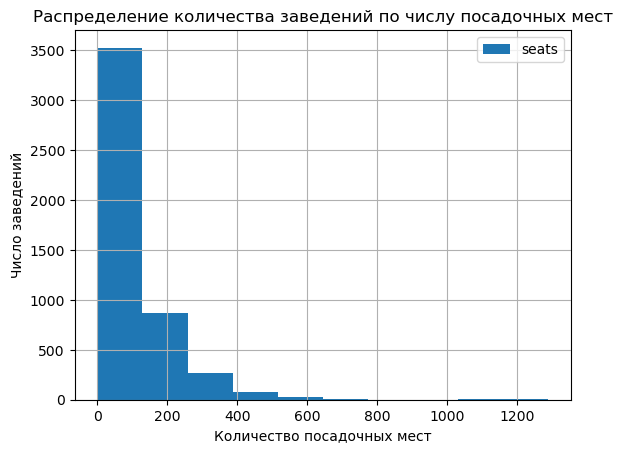

In [21]:
df.hist(column='seats',legend=True)
plt.title('Распределение числа посадочных мест')
plt.ylabel('Число заведений')
plt.xlabel('Количество посадочных мест')
plt.title('Распределение количества заведений по числу посадочных мест')
plt.show()

Число посадочных мест представлено в виде дробного числа, при этом наблюдаются значения выше 1000 человек. Скорее всего, это заведения в фудкортах или гастромаркетах, и владельцы занесли информацию об общем числе человек, на которых рассчитано пространство. При этом, больше всего значений сосредоточено  в пределах 200 человек, а выбивающихся значений предельно мало. При дальнейшем исследовании нужно иметь в виду подобное необычное распределение данных, но избавляться от них нелзя, поскольку строки могут содержать иную важную для исследования информацию.

Можем посмотреть, где располагаются подобные необычные заведения.

In [22]:
df[df['seats'] >= 1000.0]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2712,Ваня и Гоги,"бар,паб","Москва, Измайловское шоссе, 71, корп. А",Восточный административный округ,"ежедневно, 11:00–06:00",55.789842,37.750282,4.2,высокие,Средний счёт:1000–2500 ₽,1750.0,NaN,0,1040.0
2721,Маргарита,быстрое питание,"Москва, Измайловское шоссе, 71, корп. А",Восточный административный округ,"ежедневно, 10:00–22:00",55.789527,37.752004,4.3,NaN,NaN,NaN,NaN,1,1040.0
2769,Шоколадница,кофейня,"Москва, Измайловское шоссе, 71, корп. А",Восточный административный округ,"пн-ср 11:00–23:00; чт 11:00–00:00; пт,сб 11:00...",55.789903,37.749822,4.1,NaN,NaN,NaN,NaN,1,1040.0
2965,Матрешка,кафе,"Москва, Измайловское шоссе, 71, корп. А",Восточный административный округ,NaN,55.789867,37.749656,4.0,NaN,NaN,NaN,NaN,0,1040.0
4230,РестоБар Argomento,столовая,"Москва, Кутузовский проспект, 41, стр. 1",Западный административный округ,"ежедневно, 12:00–23:00",55.738237,37.531819,4.2,высокие,Средний счёт:2500–5000 ₽,3750.0,NaN,0,1200.0
6517,DelonixCafe,ресторан,"Москва, проспект Вернадского, 94, корп. 1",Западный административный округ,"ежедневно, круглосуточно",55.652577,37.475730,4.1,высокие,Средний счёт:1500–2000 ₽,1750.0,NaN,0,1288.0
6523,Ян Примус,ресторан,"Москва, проспект Вернадского, 121, корп. 1",Западный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.657166,37.481519,4.5,выше среднего,Средний счёт:1500 ₽,1500.0,NaN,1,1288.0
6573,Мюнгер,пиццерия,"Москва, проспект Вернадского, 97, корп. 1",Западный административный округ,"пн-пт 08:00–21:00; сб,вс 10:00–21:00",55.667505,37.491001,4.8,NaN,NaN,NaN,NaN,1,1288.0
6640,One Price Coffee,кофейня,"Москва, проспект Вернадского, 84, стр. 1",Западный административный округ,"ежедневно, 08:30–20:00",55.665129,37.478635,4.3,NaN,NaN,NaN,NaN,1,1288.0
6657,ГудБар,"бар,паб","Москва, проспект Вернадского, 97, корп. 1",Западный административный округ,"пн-пт 11:00–23:00; сб,вс 13:00–23:00",55.667327,37.490601,4.1,средние,Средний счёт:700 ₽,700.0,NaN,0,1288.0


Очень интересно, что заведения с более 1000 посадочных мест сосредоточены в ЗАО и ВАО. И если в Измайлово логика прослеживается - заведения находится в гостиничном комплексе, то "Яндекс Лавка" на Вернадского кажется совершенно не к месту. От нее определенно можно избавиться, притом дополнительных данных в строке нет.

Также, если обратить внимание на то, что указано одинаковое число 1288 - можно предположить, что в этих данных есть какая-то ошибка или некий умысел.

Чтобы не затронуть иные данные срезами, удалим строки по индексам.

In [23]:
df = df.drop(index=[2721,2769,2965,6573,6640,6683,6689,6770,6806,6807,6837]).reset_index(drop=True)

In [24]:
df[df['seats'] >= 1000.0]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2712,Ваня и Гоги,"бар,паб","Москва, Измайловское шоссе, 71, корп. А",Восточный административный округ,"ежедневно, 11:00–06:00",55.789842,37.750282,4.2,высокие,Средний счёт:1000–2500 ₽,1750.0,NaN,0,1040.0
4227,РестоБар Argomento,столовая,"Москва, Кутузовский проспект, 41, стр. 1",Западный административный округ,"ежедневно, 12:00–23:00",55.738237,37.531819,4.2,высокие,Средний счёт:2500–5000 ₽,3750.0,NaN,0,1200.0
6514,DelonixCafe,ресторан,"Москва, проспект Вернадского, 94, корп. 1",Западный административный округ,"ежедневно, круглосуточно",55.652577,37.475730,4.1,высокие,Средний счёт:1500–2000 ₽,1750.0,NaN,0,1288.0
6520,Ян Примус,ресторан,"Москва, проспект Вернадского, 121, корп. 1",Западный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.657166,37.481519,4.5,выше среднего,Средний счёт:1500 ₽,1500.0,NaN,1,1288.0
6652,ГудБар,"бар,паб","Москва, проспект Вернадского, 97, корп. 1",Западный административный округ,"пн-пт 11:00–23:00; сб,вс 13:00–23:00",55.667327,37.490601,4.1,средние,Средний счёт:700 ₽,700.0,NaN,0,1288.0


Стало лучше, но не совсем. Самое главное - остались данные по среднему счету и категории цен. Посадочные места оставим как есть, поскольку скорректировать их нельзя, но будем иметь факт в виду при дальнейшем исследовании

В прошлой выборке нам встретилась "Яндекс Лавка". Фактически, рестораном сервис не является, а доставляет еду. Единственное "фирменное" кафе Лавки было в Парке Горького, но сейчас (март 2023) оно закрыто, и не факт, что откроется. Поэтому посмотрим, сколько записей есть с "Лавкой".

In [25]:
df[df['name'].str.match('Яндекс')]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
162,Яндекс Лавка,ресторан,"Москва, Дмитровское шоссе, 107с17",Северный административный округ,"ежедневно, 07:00–00:00",55.881291,37.539301,4.3,NaN,NaN,NaN,NaN,1,NaN
193,Яндекс Лавка,ресторан,"Москва, Алтуфьевское шоссе, 79А, стр. 25",Северо-Восточный административный округ,"ежедневно, 07:00–00:00",55.886778,37.584891,3.3,NaN,NaN,NaN,NaN,1,NaN
212,Яндекс Лавка,ресторан,"Москва, Алтуфьевское шоссе, 50",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.877394,37.587687,4.2,NaN,NaN,NaN,NaN,1,22.0
835,Яндекс Лавка,ресторан,"Москва, Дубнинская улица, 12, корп. 2",Северный административный округ,NaN,55.864447,37.569733,4.0,NaN,NaN,NaN,NaN,1,124.0
1040,Яндекс Лавка,ресторан,"Москва, улица Лётчика Бабушкина, 15",Северо-Восточный административный округ,"ежедневно, 07:00–00:00",55.863546,37.673501,4.2,NaN,NaN,NaN,NaN,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7812,Яндекс Лавка,ресторан,"Москва, Михневская улица, 5, корп. 1, стр. 2",Южный административный округ,"ежедневно, 07:00–00:00",55.585162,37.661543,4.3,NaN,NaN,NaN,NaN,1,0.0
7824,Яндекс Лавка,ресторан,"Москва, Булатниковская улица, 2, корп. 2",Южный административный округ,"ежедневно, 07:00–00:00",55.581429,37.652566,4.1,NaN,NaN,NaN,NaN,1,65.0
7955,Яндекс Лавка,ресторан,"Москва, улица Генерала Белова, 28, стр. 4",Южный административный округ,"ежедневно, 07:00–00:00",55.605422,37.723158,3.5,NaN,NaN,NaN,NaN,1,75.0
7966,Яндекс Лавка,ресторан,"Москва, Шипиловский проезд, 65, корп. 1",Южный административный округ,"ежедневно, 07:00–00:00",55.599020,37.714239,3.5,NaN,NaN,NaN,NaN,1,75.0


Определенно, Яндекс Лавка в разных своих ипостасях может испортить всё исследование, особенно изучение сетевых заведений. Поскольку заведением общепита она не является - удаляем.

In [26]:
df = df[df["name"].str.contains("Яндекс")== False ]

In [27]:
df[df['name'].str.match('Яндекс')]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


Теперь Яндекс не помешает Лавкой в исследовании.

### Обработка пропущенных значений

Изучим пропуски в данных и посмотрим, что можно с ними сделать.

In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8321 entries, 0 to 8392
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8321 non-null   object 
 1   category           8321 non-null   object 
 2   address            8321 non-null   object 
 3   district           8321 non-null   object 
 4   hours              7791 non-null   object 
 5   lat                8321 non-null   float64
 6   lng                8321 non-null   float64
 7   rating             8321 non-null   float64
 8   price              3313 non-null   object 
 9   avg_bill           3814 non-null   object 
 10  middle_avg_bill    3147 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8321 non-null   int64  
 13  seats              4748 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 975.1+ KB


Пропуски в часах работы и посадочных местах заполнить невозможно - для этого необходимо провести значительнуюю работу "в поле" и изучать каждое из пропущенных заведений. Поэтому оставим их как есть.

Заполнить среднее значение счета также невозможно отдельно по имеющимся данным - известно, что столбец middle_avg_bill — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт». Соответственно, если в строке указано другое (цена чашки кофе/капучино/пива и прочего) - судить о среднем счете заведения невозможно, не имея данных обо всем меню и среднем чеке. Такие данные можно дополнить только в случае совмещения с базой данных по электронным чекам, либо банковским операциям, свойственным данной конкретной точке. Ввиду закрытости таких данных, это невозможно в текущих условиях рассматриваемой задачи.

При этом есть возможность оценить, какие значения входят в категорийные переменные цен в заведении. Поэтому для изучения вопроса посмотрим какие значения свойственны для каждой категории.

In [29]:
price_cat_temp = df[['price', 'avg_bill','middle_avg_bill']]
price_cat_temp.head(10)

,price,avg_bill,middle_avg_bill
0,NaN,NaN,NaN
1,выше среднего,Средний счёт:1500–1600 ₽,1550.0
2,средние,Средний счёт:от 1000 ₽,1000.0
3,NaN,Цена чашки капучино:155–185 ₽,NaN
4,средние,Средний счёт:400–600 ₽,500.0
5,средние,NaN,NaN
6,средние,Средний счёт:199 ₽,199.0
7,средние,Средний счёт:200–300 ₽,250.0
8,средние,Средний счёт:от 500 ₽,500.0
9,средние,Средний счёт:1000–1200 ₽,1100.0


In [30]:
for price_cat in price_cat_temp['price'].dropna().unique():
    temp = price_cat_temp[price_cat_temp['price'] == price_cat]
    print ('Категория цен:', price_cat)
    print ('Максимальное значение:', temp['middle_avg_bill'].max())
    print ('Минимальное значение:', temp['middle_avg_bill'].min())
    print ('Среднее значение:', temp['middle_avg_bill'].mean())
    print ('Медианное значение:', temp['middle_avg_bill'].median())
    print()

Категория цен: выше среднего
Максимальное значение: 4500.0
Минимальное значение: 375.0
Среднее значение: 1344.1891891891892
Медианное значение: 1250.0

Категория цен: средние
Максимальное значение: 2150.0
Минимальное значение: 165.0
Среднее значение: 598.908273381295
Медианное значение: 500.0

Категория цен: высокие
Максимальное значение: 10000.0
Минимальное значение: 0.0
Среднее значение: 2378.2528735632186
Медианное значение: 2000.0

Категория цен: низкие
Максимальное значение: 600.0
Минимальное значение: 90.0
Среднее значение: 217.31182795698925
Медианное значение: 180.0



Таким образом становится понятна логика присуждения категорий ценам в заведениях: для "низких" медианное значение цены - 180 рублей, для "средних" - 500 рублей, для "выше среднего" - 1250 рублей, для "высоких" - 2000 рублей. Выделим из общего набора данных строки, где есть данные о ценовой категории и нет данных о среднем счете.

In [31]:
df[(df['middle_avg_bill'].isna())&(df['price'].notna())]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN
10,Great Room Bar,"бар,паб","Москва, Левобережная улица, 12",Северный административный округ,"ежедневно, круглосуточно",55.877832,37.469171,4.5,средние,Цена бокала пива:250–350 ₽,NaN,NaN,0,102.0
67,Штаб квартира,"бар,паб","Москва, Дубнинская улица, 32",Северный административный округ,"пн-чт 12:30–00:00; пт,сб 12:30–02:00; вс 12:30...",55.883112,37.558867,5.0,средние,Цена бокала пива:120–350 ₽,NaN,NaN,0,16.0
72,Лакрица,кофейня,"Москва, Алтуфьевское шоссе, 85",Северо-Восточный административный округ,"ежедневно, 08:00–21:00",55.891196,37.585653,4.5,средние,Цена чашки капучино:150–190 ₽,NaN,170.0,0,12.0
89,Сахарочек,кофейня,"Москва, Дмитровское шоссе, 107А, корп. 2",Северный административный округ,пн-пт 09:00–22:00; сб 10:00–22:00; вс 10:00–21:00,55.879256,37.538444,4.5,средние,Цена чашки капучино:100–200 ₽,NaN,150.0,0,120.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8322,Baer Coffee,кофейня,"Москва, Окская улица, 1, корп. 1",Юго-Восточный административный округ,пн 00:00–21:00; вт-сб 09:00–21:00; вс 00:00–21:00,55.711757,37.751269,4.4,низкие,Цена чашки капучино:120–180 ₽,NaN,150.0,0,80.0
8335,Bonjour,кофейня,"Москва, Шоссейная улица, 8",Юго-Восточный административный округ,"пн-пт 07:30–21:00; сб,вс 08:00–21:00",55.689958,37.725969,4.7,средние,Цена чашки капучино:130–190 ₽,NaN,160.0,0,NaN
8367,Айоку,ресторан,"Москва, улица Генерала Кузнецова, 17",Юго-Восточный административный округ,"ежедневно, 10:00–23:00",55.686279,37.858321,4.2,средние,NaN,NaN,NaN,0,10.0
8374,Pab&burg,"бар,паб","Москва, улица Михайлова, 22, корп. 4",Юго-Восточный административный округ,"ежедневно, 12:00–21:30",55.726303,37.769842,4.2,средние,Цена бокала пива:от 140 ₽,NaN,NaN,0,NaN


Заполним пропуски медианными значениями среднего счета для категорий.

In [32]:
for cat in df['price'].unique():
    df.loc[(df['price'] == cat) & (df['middle_avg_bill'].isna()), 'middle_avg_bill'] = \
    df.loc[(df['price'] == cat), 'middle_avg_bill'].median()

На всякий случай проверим, вдруг есть записи, где значение есть, но оно равно нулю и попробуем с ним разобраться.

In [33]:
df.query('middle_avg_bill == 0 & price != 0')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
3684,Кофемания,кофейня,"Москва, улица Новый Арбат, 19",Центральный административный округ,"ежедневно, круглосуточно",55.752136,37.587784,4.5,высокие,Средний счёт:от 0 ₽,0.0,NaN,1,200.0


Значение можно заполнить медианным для всеё сети "Кофемания", а значение среднего счета - характерным для сети.

Изучим данные по всей сети.

In [34]:
df.query('name == "Кофемания"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1376,Кофемания,кофейня,"Москва, Ленинградское шоссе, 16Ас4",Северный административный округ,"ежедневно, 09:00–23:00",55.822030,37.496661,4.4,высокие,Средний счёт:1400 ₽,1400.0,NaN,1,NaN
1450,Кофемания,кофейня,"Москва, Хорошёвское шоссе, 27",Северный административный округ,"пн-пт 08:00–22:00; сб,вс 09:00–22:00",55.777620,37.523223,4.4,высокие,Средний счёт:1500–2500 ₽,2000.0,NaN,1,45.0
1789,Кофемания,кофейня,"Москва, Ленинградский проспект, 37А, корп. 14,...",Северный административный округ,"ежедневно, круглосуточно",55.790899,37.542776,4.7,NaN,NaN,NaN,NaN,1,15.0
1869,Кофемания,кофейня,"Москва, Лесная улица, 20, стр. 3",Центральный административный округ,"пн-пт 09:00–22:00; сб,вс 10:00–22:00",55.780074,37.592099,4.4,средние,Средний счёт:700–1400 ₽,1050.0,NaN,1,500.0
1882,Кофемания,кофейня,"Москва, Лесная улица, 5",Центральный административный округ,"ежедневно, круглосуточно",55.777804,37.586346,4.4,высокие,Средний счёт:2000 ₽,2000.0,NaN,1,140.0
3009,Кофемания,кофейня,"Москва, Осенняя улица, 11",Западный административный округ,пн-ср 08:00–23:00; чт-сб 08:00–00:00; вс 08:00...,55.762272,37.404399,4.9,NaN,NaN,NaN,NaN,1,70.0
3505,Кофемания,кофейня,"Москва, Кудринская площадь, 46/54с1",Центральный административный округ,"ежедневно, круглосуточно",55.758268,37.585356,4.4,высокие,Средний счёт:1500–2500 ₽,2000.0,NaN,1,NaN
3647,Кофемания,кофейня,"Москва, 1-я Тверская-Ямская улица, 21",Центральный административный округ,"ежедневно, 08:00–00:00",55.774743,37.587550,4.4,высокие,Средний счёт:1500–2500 ₽,2000.0,NaN,1,125.0
3681,Кофемания,кофейня,"Москва, Большая Никитская улица, 13",Центральный административный округ,"ежедневно, круглосуточно",55.756507,37.604838,4.5,высокие,Средний счёт:2500 ₽,2500.0,NaN,1,148.0
3684,Кофемания,кофейня,"Москва, улица Новый Арбат, 19",Центральный административный округ,"ежедневно, круглосуточно",55.752136,37.587784,4.5,высокие,Средний счёт:от 0 ₽,0.0,NaN,1,200.0


... И не заполним данные по среднему счету. Учитывая особенность Кофемании, как кофейни высокого класса, средний счет может зависеть уже не от политики сети, а от местоположения. Но медианным значением по сети заполнить пропуски среднего чека вполне можно.

In [35]:
df.loc[(df['name'] == 'Кофемания') & (df['middle_avg_bill'].isna()), 'middle_avg_bill'] = \
    df.loc[(df['name'] == 'Кофемания'), 'middle_avg_bill'].median()
df.loc[(df['name'] == 'Кофемания') & (df['middle_avg_bill'] == 0), 'middle_avg_bill'] = \
    df.loc[(df['name'] == 'Кофемания'), 'middle_avg_bill'].median()

In [36]:
df.query('name == "Кофемания"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1376,Кофемания,кофейня,"Москва, Ленинградское шоссе, 16Ас4",Северный административный округ,"ежедневно, 09:00–23:00",55.822030,37.496661,4.4,высокие,Средний счёт:1400 ₽,1400.0,NaN,1,NaN
1450,Кофемания,кофейня,"Москва, Хорошёвское шоссе, 27",Северный административный округ,"пн-пт 08:00–22:00; сб,вс 09:00–22:00",55.777620,37.523223,4.4,высокие,Средний счёт:1500–2500 ₽,2000.0,NaN,1,45.0
1789,Кофемания,кофейня,"Москва, Ленинградский проспект, 37А, корп. 14,...",Северный административный округ,"ежедневно, круглосуточно",55.790899,37.542776,4.7,NaN,NaN,2000.0,NaN,1,15.0
1869,Кофемания,кофейня,"Москва, Лесная улица, 20, стр. 3",Центральный административный округ,"пн-пт 09:00–22:00; сб,вс 10:00–22:00",55.780074,37.592099,4.4,средние,Средний счёт:700–1400 ₽,1050.0,NaN,1,500.0
1882,Кофемания,кофейня,"Москва, Лесная улица, 5",Центральный административный округ,"ежедневно, круглосуточно",55.777804,37.586346,4.4,высокие,Средний счёт:2000 ₽,2000.0,NaN,1,140.0
3009,Кофемания,кофейня,"Москва, Осенняя улица, 11",Западный административный округ,пн-ср 08:00–23:00; чт-сб 08:00–00:00; вс 08:00...,55.762272,37.404399,4.9,NaN,NaN,2000.0,NaN,1,70.0
3505,Кофемания,кофейня,"Москва, Кудринская площадь, 46/54с1",Центральный административный округ,"ежедневно, круглосуточно",55.758268,37.585356,4.4,высокие,Средний счёт:1500–2500 ₽,2000.0,NaN,1,NaN
3647,Кофемания,кофейня,"Москва, 1-я Тверская-Ямская улица, 21",Центральный административный округ,"ежедневно, 08:00–00:00",55.774743,37.587550,4.4,высокие,Средний счёт:1500–2500 ₽,2000.0,NaN,1,125.0
3681,Кофемания,кофейня,"Москва, Большая Никитская улица, 13",Центральный административный округ,"ежедневно, круглосуточно",55.756507,37.604838,4.5,высокие,Средний счёт:2500 ₽,2500.0,NaN,1,148.0
3684,Кофемания,кофейня,"Москва, улица Новый Арбат, 19",Центральный административный округ,"ежедневно, круглосуточно",55.752136,37.587784,4.5,высокие,Средний счёт:от 0 ₽,2000.0,NaN,1,200.0


Единственная Кофемания на Лесной - со средними ценами. Видимо сказывается расположение в гастромаркете.

При этом в обратную сторону заполнять категорию цен на основе среднего чека не будем, поскольку в этом случае недостаточно данных для понимания конкретной методики присвоения категорий для тех или иных заведений.

На всякий случай убедимся, что в сетевых заведениях нет пропусков в значении среднего чека. Если есть - аналогично заполним медианой.

In [37]:
df[((df['middle_avg_bill'].isna())|(df['middle_avg_bill'] == 0))&(df['chain'] == 1)&(df['avg_bill'].notna())]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
81,Coffee Way,кофейня,"Москва, Алтуфьевское шоссе, 86, корп. 1",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.897789,37.588189,4.3,NaN,Цена чашки капучино:120–170 ₽,NaN,145.0,1,120.0
151,Шоколадница,кофейня,"Москва, Дмитровское шоссе, 163Ак1",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.910447,37.542227,4.1,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,1,NaN
240,Шоколадница,кофейня,"Москва, Широкая улица, 13А",Северо-Восточный административный округ,"ежедневно, 10:00–21:00",55.887990,37.662485,4.1,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,1,75.0
343,Шоколадница,кофейня,"Москва, Фестивальная улица, 13, корп. 1",Северный административный округ,"ежедневно, 08:00–23:00",55.855703,37.477670,4.3,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,1,100.0
344,Coffee Moose,кофейня,"Москва, улица Героев Панфиловцев, 2",Северо-Западный административный округ,"пн-пт 08:00–21:00; сб,вс 10:00–21:00",55.851766,37.440266,4.4,NaN,Цена чашки капучино:119–179 ₽,NaN,149.0,1,120.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7689,Krispy Kreme,кофейня,"Москва, Кировоградская улица, 13А",Южный административный округ,"ежедневно, 10:00–22:00",55.611884,37.608123,4.3,NaN,Цена чашки капучино:205–280 ₽,NaN,242.0,1,250.0
7794,I-cup,кофейня,"Москва, Шипиловский проезд, вл39с2",Южный административный округ,"ежедневно, 07:00–21:00",55.612696,37.695943,4.7,NaN,Цена чашки капучино:от 60 ₽,NaN,60.0,1,NaN
7884,Шоколадница,кофейня,"Москва, Ореховый бульвар, 14к3",Южный административный округ,"ежедневно, 10:00–22:00",55.609682,37.720095,4.2,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,1,NaN
7897,Cofix,кофейня,"Москва, Ореховый бульвар, 22А",Южный административный округ,"ежедневно, 09:00–22:00",55.612312,37.731524,4.2,NaN,Цена чашки капучино:от 60 ₽,NaN,60.0,1,80.0


... И мы убедились что они есть. Однако их немного и можно провести операцию по заполнению пропусков

In [38]:
df['middle_avg_bill'] = df['middle_avg_bill'].fillna(df.groupby('name')['middle_avg_bill'].transform('median'))

In [39]:
df[((df['middle_avg_bill'].isna())|(df['middle_avg_bill'] == 0))&(df['chain'] == 1)&(df['avg_bill'].notna())]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
344,Coffee Moose,кофейня,"Москва, улица Героев Панфиловцев, 2",Северо-Западный административный округ,"пн-пт 08:00–21:00; сб,вс 10:00–21:00",55.851766,37.440266,4.4,NaN,Цена чашки капучино:119–179 ₽,NaN,149.0,1,120.0
542,Coffee Guru,кофейня,"Москва, Смольная улица, 24Д",Северный административный округ,пн-пт 08:00–19:00,55.860723,37.484066,4.1,NaN,Цена чашки капучино:от 89 ₽,NaN,89.0,1,115.0
1046,Wild Bean Cafe,кофейня,"Москва, Ярославское шоссе, вл3с3",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.851778,37.676423,4.5,NaN,Цена чашки капучино:140–200 ₽,NaN,170.0,1,NaN
1445,9 Bar Coffee,кофейня,"Москва, Ленинградский проспект, 80, корп. 1",Северный административный округ,"пн-пт 07:30–21:00; сб,вс 07:30–19:00",55.810352,37.506625,4.3,NaN,Цена чашки капучино:60–150 ₽,NaN,105.0,1,625.0
1481,Кофе & Moloko,кофейня,"Москва, Авиационная улица, 77",Северо-Западный административный округ,"пн-пт 08:00–21:00; сб,вс 10:00–21:00",55.808008,37.450559,4.1,NaN,Цена чашки капучино:220–320 ₽,NaN,270.0,1,NaN
1544,Fresh,кофейня,"Москва, улица Клары Цеткин, 4А",Северный административный округ,пн-пт 09:00–17:00,55.818442,37.519020,4.1,NaN,Цена чашки капучино:95 ₽,NaN,95.0,1,NaN
1864,CoffeeShots,кофейня,"Москва, улица Правды, 24с4",Северный административный округ,"пн-пт 08:00–20:00; сб,вс 09:00–20:00",55.789598,37.583553,4.3,NaN,Цена чашки капучино:100–170 ₽,NaN,135.0,1,NaN
1865,Coffee Guru,кофейня,"Москва, Новодмитровская улица, 2, корп. 1",Северо-Восточный административный округ,"пн-пт 08:00–21:00; сб,вс 11:00–21:00",55.804887,37.589675,4.2,NaN,Цена чашки капучино:от 89 ₽,NaN,89.0,1,80.0
2159,Point 242,кофейня,"Москва, проспект Мира, 61",Центральный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.785840,37.634606,4.7,NaN,Цена чашки капучино:от 230 ₽,NaN,230.0,1,45.0
2265,Noba coffee,кофейня,"Москва, Ботанический переулок, 5",Центральный административный округ,"ежедневно, 08:00–19:00",55.777973,37.637756,4.6,NaN,Цена чашки капучино:180–200 ₽,NaN,190.0,1,80.0


Пропусков стало значительно меньше, их наличие, скорее всего, может быть обусловлено отсутствием данных по среднему чеку в сети вообще. Ввиду невозможности дальнейшего заполнения этих пропусков - оставим в текущем состоянии.

Теперь проведем аналогичную операцию для отсутствующей информации по средней цене или среднему счету в столбце avg_bill, но в случае текстовых данных, заполним пропуски модальным значением для сети.

In [40]:
df[(df['avg_bill'].isna())&(df['chain'] == 1)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
13,Буханка,булочная,"Москва, Базовская улица, 15, корп. 1",Северный административный округ,"ежедневно, 08:00–22:00",55.877007,37.504980,4.8,NaN,NaN,237.5,NaN,1,180.0
19,Пекарня,булочная,"Москва, Ижорский проезд, 5",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,1,NaN
20,Чебуреки Манты,кафе,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.880287,37.448646,4.3,NaN,NaN,250.0,NaN,1,148.0
23,Буханка,булочная,"Москва, Лобненская улица, 13к2",Северный административный округ,"ежедневно, 08:00–22:00",55.888421,37.527106,4.7,NaN,NaN,237.5,NaN,1,NaN
24,Drive Café,кафе,"Москва, улица Дыбенко, 9Ас1",Северный административный округ,"ежедневно, круглосуточно",55.879992,37.481571,4.0,NaN,NaN,NaN,NaN,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8253,Беседка,кафе,"Москва, Юго-Восточный административный округ, ...",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690708,37.787755,4.2,NaN,NaN,NaN,NaN,1,NaN
8261,Ли,кафе,"Москва, Рязанский проспект, 30, корп. 2",Юго-Восточный административный округ,"ежедневно, 10:30–21:00",55.718076,37.783650,4.7,NaN,NaN,NaN,NaN,1,116.0
8304,Беседка,кафе,"Москва, Кузьминская улица, 10",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690691,37.787735,4.1,NaN,NaN,NaN,NaN,1,NaN
8366,Лагман Хаус,кафе,"Москва, Новороссийская улица, 14, стр. 2",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.678772,37.759422,4.3,NaN,NaN,NaN,NaN,1,40.0


In [41]:
df['avg_bill'] = df['avg_bill'].fillna(df.groupby('name')['avg_bill'].transform(lambda x: x.mode()[0] if not x.mode().empty else np.nan))

In [42]:
df[(df['avg_bill'].isna())&(df['chain'] == 1)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
19,Пекарня,булочная,"Москва, Ижорский проезд, 5",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,1,NaN
24,Drive Café,кафе,"Москва, улица Дыбенко, 9Ас1",Северный административный округ,"ежедневно, круглосуточно",55.879992,37.481571,4.0,NaN,NaN,NaN,NaN,1,NaN
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN
51,Арамье,булочная,"Москва, Ангарская улица, 30/25",Северный административный округ,"ежедневно, 09:00–21:00",55.878014,37.522867,3.7,NaN,NaN,NaN,NaN,1,NaN
54,Шашлык,быстрое питание,"Москва, Коровинское шоссе, 46, стр. 5",Северный административный округ,"ежедневно, круглосуточно",55.887978,37.515823,3.9,NaN,NaN,NaN,NaN,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8245,Ли,кафе,"Москва, Рязанский проспект, 79",Юго-Восточный административный округ,"ежедневно, 10:30–22:30",55.717199,37.795580,4.8,NaN,NaN,NaN,NaN,1,20.0
8253,Беседка,кафе,"Москва, Юго-Восточный административный округ, ...",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690708,37.787755,4.2,NaN,NaN,NaN,NaN,1,NaN
8261,Ли,кафе,"Москва, Рязанский проспект, 30, корп. 2",Юго-Восточный административный округ,"ежедневно, 10:30–21:00",55.718076,37.783650,4.7,NaN,NaN,NaN,NaN,1,116.0
8304,Беседка,кафе,"Москва, Кузьминская улица, 10",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690691,37.787735,4.1,NaN,NaN,NaN,NaN,1,NaN


### Обработка дубликатов

Изучим встречающиеся дубликаты. Они могут быть как сетевыми, так и несетевыми. Главным критерием для отбора дубликата будет совпадение и адреса и наименования.

In [43]:
df.duplicated().sum()

0

Полных дубликатов в данных нет, это уже хорошо.

Проверим наличие дубликатов в части названий несетевых заведений.

In [44]:
df.query('name.duplicated(keep=False) & chain == 0').count()

name                 364
category             364
address              364
district             364
hours                230
lat                  364
lng                  364
rating               364
price                 25
avg_bill             311
middle_avg_bill      323
middle_coffee_cup      0
chain                364
seats                174
dtype: int64

Всего записей с дубликатами имен среди несетевых заведений 364. Однако среди них могут быть кафе "Кафе", рестораны "Ресторан", пивные "Пивная" и прочие образчики нежелания человека придумывать какое-либо название для своего заведения. Поэтому добавим в качестве критерия совпадающий адрес, а критерий сетевого заведения уберем.

In [45]:
df.query('name.duplicated(keep=False) & address.duplicated()').count()

name                 1175
category             1175
address              1175
district             1175
hours                1088
lat                  1175
lng                  1175
rating               1175
price                 322
avg_bill              904
middle_avg_bill       909
middle_coffee_cup     104
chain                1175
seats                 835
dtype: int64

Число заведений выросло, к дублированным именам добавились совпадающие адреса, при этом ушел ограничитель сетевого заведения. Такой результат в принципе неудивителен, поскольку кафе и рестораны могут размещаться в торговых центрах разного размера и ценовой категории, и называться могут одинаково. Можно, наверное, даже встретить две "Шоколадницы" в каком-нибудь крупном торговом центре, разделенном на несколько корпусов (к примеру, "Мега").

По итогу, для исследования достался весьма чистый датасет, и откровенных дубликатов в нем нет. Остальные данные приведены к единому виду и исправлены ошибки в них. Остался последний шаг - дополнение данных новыми столбцами и далее уже само исследование.

## Дополнение данных

Добавим столбец street с названиями улиц из столбца с адресом для последующего изучения распределения заведений по улицам и определения наиболее "питательных" улиц Москвы.

Также создадим категориальный столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7). Это понадобится для последующего исследования доли круглосуточных заведений в городе.

In [46]:
def get_street(addr):
    try:
        values = addr.split(',')
        return values[1]
    except:
        pass

In [47]:
df['street'] = df['address'].apply(get_street)

In [48]:
df['street'].value_counts()

 проспект Мира                 184
 Профсоюзная улица             121
 Ленинский проспект            106
 проспект Вернадского           99
 Ленинградский проспект         95
                              ... 
 Дурасовский переулок            1
 Яковоапостольский переулок      1
 улица Максимова                 1
 Малый Казённый переулок         1
 Чонгарский бульвар              1
Name: street, Length: 1442, dtype: int64

In [49]:
df['hours'].value_counts().head(10)

ежедневно, 10:00–22:00      758
ежедневно, круглосуточно    721
ежедневно, 11:00–23:00      396
ежедневно, 10:00–23:00      309
ежедневно, 12:00–00:00      254
ежедневно, 09:00–21:00      204
ежедневно, 09:00–22:00      184
ежедневно, 12:00–23:00      178
ежедневно, 08:00–23:00      159
ежедневно, 08:00–22:00      148
Name: hours, dtype: int64

Ежедневных много, а круглосуточные только 728 заведений.

In [50]:
def cat_24_7(hours):
    try:
        if 'ежедневно, круглосуточно' in hours:
            return 1
        else:
            return 0
    except:
        pass

In [51]:
df['is_24/7'] = df['hours'].apply(cat_24_7)

In [52]:
df['is_24/7'].value_counts()

0.0    7070
1.0     721
Name: is_24/7, dtype: int64

Всё получилось, начинаем анализ.

## Анализ полученных данных

Проанализируем весь набор данных, а именно: типы заведений, количество посадочных мест, принадлежность заведений к сетевым, составим топ-15 самых больших сетей Москвы, оценим рейтинги заведений, их расположение на карте, ценовую политику. Также, возможно, в течение исследования будут появляться интересные закономерности, которые также могут быть исследованы.

Для работы с диаграммами и графиками используем plotly express.

### Категории заведений

Начнем с категорий заведений. Для этого используем сводную таблицу, в которой будут наименования категорий и количество заведений в категории. Для наглядности далее построим круговую диаграмму, чтобы наглядно понять, какие заведения самые распространенные в Москве.

In [53]:
cat_pivot = df.pivot_table(index='category',values='name',aggfunc='count').reset_index()
cat_pivot.columns=['category','count']
cat_pivot

,category,count
0,"бар,паб",763
1,булочная,256
2,быстрое питание,602
3,кафе,2375
4,кофейня,1410
5,пиццерия,632
6,ресторан,1968
7,столовая,315


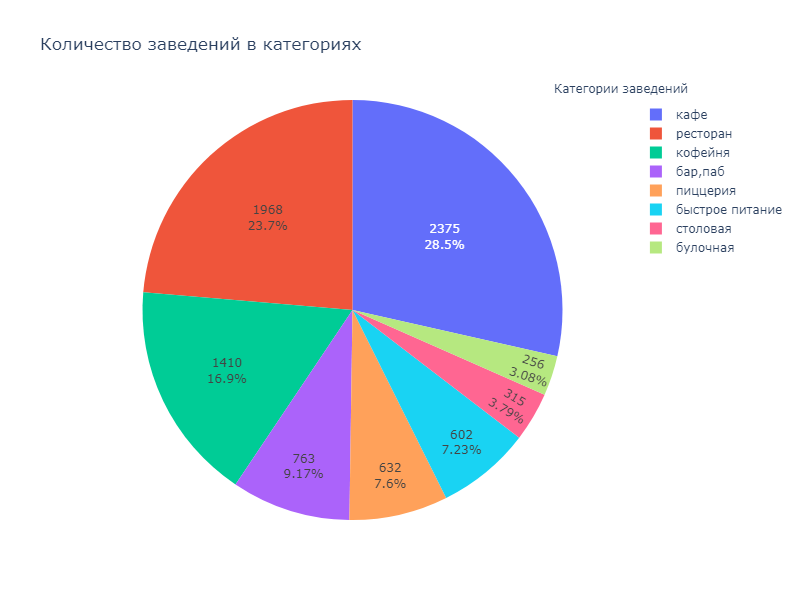

In [54]:
fig = go.Figure(data=[go.Pie(labels=cat_pivot['category'], values=cat_pivot['count'])])
fig.update_layout(title='Количество заведений в категориях',
                  width=800, 
                  height=600,
                  annotations=[dict(x=1.12, 
                                    y=1.05,
                                    text='Категории заведений',
                                    showarrow=False)])
fig.update_traces(textinfo='percent+value')
fig.show("png")

Круговая диаграмма показывает, что тройка самых часто встречающихся заведений в Москве - это кафе, ресторан и кофейня. По большому счету это логично с той позиции, что кафе и рестораны - это традиционно имевшиеся в Москве заведения еще с незапамятных времен. Так же и кофейни - еще со времен Российской Империи весьма популярные и модные (в то время) заведения. В наше время же кофейня стала атрибутом городской бешеной жизни, когда у каждого второго встреченного на улице человека в руках будет стаканчик с кофе.

### Посадочные места

Второй немаловажный фактор, который нужно исследовать, - это количество посадочных мест в заведении. На основании полученных данных можно будет сделать вывод о каждой категории заведений в Москве в разрезе человековместимости. Также это позволит оценить масштаб каждой категории заведений в городе.

Наиболее удобным графиком для анализа будет диаграмма размаха.

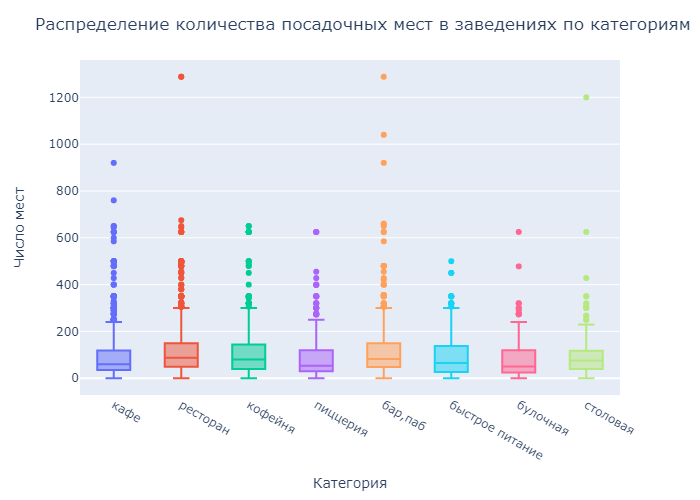

In [55]:
fig = px.box(df, x="category", y="seats", color='category')
fig.update_layout(title="Распределение количества посадочных мест в заведениях по категориям",
                  yaxis_title="Число мест",
                 xaxis_title="Категория",
                 showlegend=False)
fig.show("png")

Благодаря диаграммам размаха можно весьма наглядно оценить, какая численность посадочных мест наиболее характерна для каждого типа заведений общепита города. 

Наблюдаются отдельные "выбросы" по некоторым категориям: кафе, рестораны, пабы/бары, столовые. Возможно это связано с ошибками при заполнении данных владельцами, либо это отдельные уникальные заведения, имеющие гигантскую вместимость. Однако это не оказывает такого значительного влияния на общую характеристику каждой категории.

Интересно, что рестораны, кофейни и бары/пабы в Москве весьма похожи по своей вместимости: 75% всех заведений имеют от 40-49 до 144-150 мест для полной посадки. Медианные значения вместимости также весьма похожи и находятся в районе 80 человек.

Вторая группа похожих заведений - кафе, пиццерии и булочные. В них от 30 до 120 посадочных мест, что также неудивительно: кафе - часто малый бизнес, и для стартапа критично иметь минимально необходимую площадь для обслуживания клиентов. Пиццерии часто работают на доставку, поэтому в них не будет подразумеваться много места для клиентов. И аналогично булочные - сложно представить, что посетитель будет сидеть в булочной больше времени подготовки заказа.

Интересно, что в фастфуде 75% заведений имеют вместимость от 27 до 137 человек. Небольшой нижний порог, скорее всего, объясняется тем, что фастфуд - это не только БК, Вкусноточка, KFC/Ростик'c и прочие сети, а еще разного рода Чайханы, шаурмичные, тандыры и т.д. Фастфуд тоже в своей концепции мало подразумевает долгое пребывание в заведении.

Интересно, что в столовых от 40 до 118 посадочных мест, хотя, казалось бы, они должны быть ориентированы на разного рода заводы, ВУЗы, общежития и прочие места массовой работы и обучения людей. С другой стороны, в Москве вряд ли осталось много заводов, где в смену одновременно работает больше 100 человек.

Тем не менее, на представленном графике можно наглядно оценить распределение посадочных мест по различным категориям московских заведений.

Дополнительно посчитаем также среднее число мест для каждой категории заведения.

In [56]:
seat = df.pivot_table(index='category', values='seats', aggfunc=['mean','median']).reset_index()
seat.columns = ['category','seat_mean','seat_median']
seat

,category,seat_mean,seat_median
0,"бар,паб",122.197425,82.5
1,булочная,89.385135,50.0
2,быстрое питание,96.186782,65.0
3,кафе,94.776955,60.0
4,кофейня,106.811497,80.0
5,пиццерия,91.694836,53.5
6,ресторан,121.099757,88.0
7,столовая,99.750000,75.5


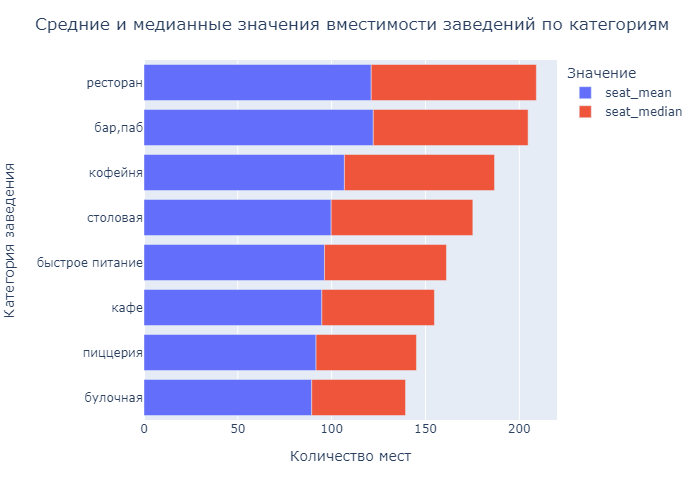

In [57]:
fig = px.bar(seat.sort_values(by='seat_median', ascending=True), # отсортируем по медианному, все же более круглая цифра
             x=['seat_mean','seat_median'], 
             y='category')

fig.update_layout(title='Средние и медианные значения вместимости заведений по категориям',
                   xaxis_title='Количество мест',
                   yaxis_title='Категория заведения',
                   legend_title="Значение")
fig.show("png")

Рестораны и пабы - самые вместительные в "рейтинге". Это понятно - места рассчитаны на длительное времяпрепровождение, а в барах/пабах часто устраивают концерты и просто дискотеки. Для таких заведений чем больше вместимость - тем выгоднее бизнес.
В свою очередь булочные по понятным причинам аутсайдеры: как правило в них несколько столиков, возможность выпить кофе, но на длительное пребывание посетителя они не рассчитаны: сюда приходят покупать хлеб.

Пиццерии же, в отличие от США и Италии, у нас нечасто забиты полностью. В основном, они работают сейчас на доставку, и поэтому нерентабельны большие помещения для таких заведений.

Интересно заметить, что среднее и медианное значения вместимости столовых несколько выше фастфуда. Но при этом также нужно помнить, что в нашей стране, в отличие от многих других стран, столовая - это, как правило, общепит при фабриках, заводах, НИИ, университетах, школах. Поэтому и мест в столовых больше. Однако, фастфуд тоже в топ-5 по количеству мест заведений. Интересно - и точка.

### Сетевые и несетевые заведения

Следующим немаловажным пунктом исследование будет определение доли сетевых и несетевых заведений, не только в общем, но и по категориям.

In [58]:
chain = df.pivot_table(index='chain',values='name',aggfunc='count').reset_index()
chain.columns=['chain','count']
chain

,chain,count
0,0,5194
1,1,3127


In [59]:
def cat_net(row):
    chain = row['chain']
    
    if chain == 1:
        return 'Сетевой'
    else:
        return 'Несетевой'
    
chain['chn_cat'] = chain.apply(cat_net, axis=1)

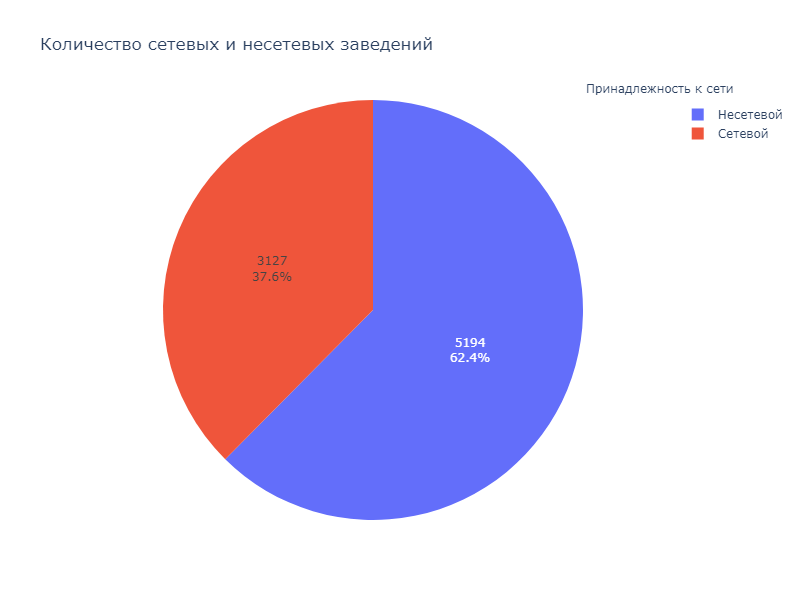

In [60]:
fig = go.Figure(data=[go.Pie(labels=chain['chn_cat'], values=chain['count'])])
fig.update_layout(title='Количество сетевых и несетевых заведений', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600,
                  annotations=[dict(x=1.12, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Принадлежность к сети',
                                    showarrow=False)])
fig.update_traces(textinfo='percent+value')
fig.show("png")

Интересно, всего 38% заведений Москвы - сетевые. Но в таком виде анализ неполный, поэтому построим более полный график, чтобы понять, какая часть каждой категории заведений Москвы является сетевой.

In [61]:
net_pivot = df.pivot_table(index=['category', 'chain'], values='name',aggfunc='count').reset_index()
net_pivot.columns=['category', 'chain', 'count']
net_pivot

,category,chain,count
0,"бар,паб",0,594
1,"бар,паб",1,169
2,булочная,0,99
3,булочная,1,157
4,быстрое питание,0,371
5,быстрое питание,1,231
6,кафе,0,1597
7,кафе,1,778
8,кофейня,0,692
9,кофейня,1,718


In [62]:
def cat_net(row):
    chain = row['chain']
    
    if chain == 1:
        return 'Сетевой'
    else:
        return 'Несетевой'
    
net_pivot['chn_cat'] = net_pivot.apply(cat_net, axis=1)

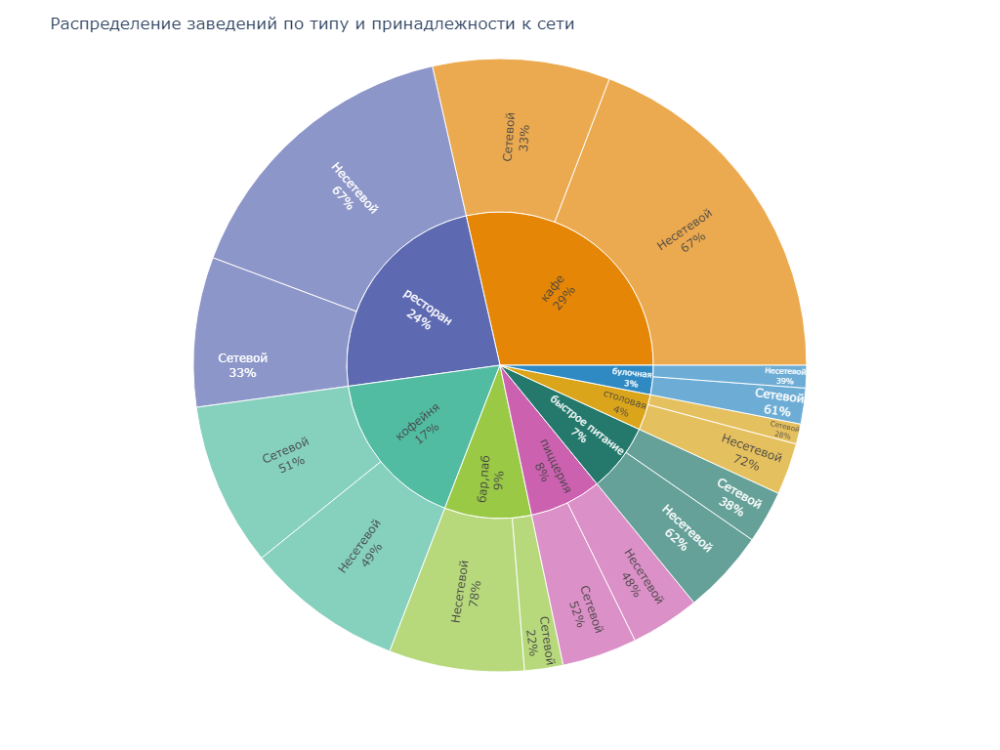

In [63]:
custom_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
fig = px.sunburst(net_pivot, path=['category', 'chn_cat'], values='count', color_discrete_sequence=px.colors.qualitative.Vivid)



fig.update_layout(title='Распределение заведений по типу и принадлежности к сети',
                  width=1024,
                  height=768)
fig.update_traces(textinfo='label+percent parent', insidetextorientation='radial')
fig.show("png")


Диаграмма явно показывает нам, что среди баров, кафе, ресторанов и столовых, "одиночных", несетевых заведений больше, чем сетевых. 

Вполне логично, что среди баров и пабов будет больше одиночных заведений - тематик для таких мест великое множество, и чаще всего их открывают люди увлекающиеся. Скорее всего, если дополнительно рассмотреть их доходность, несетевые заведения будут, скорее всего, находиться в пределах самоокупаемости. Ведь бар/паб - это, в первую очередь, идея, а уже потом - деньги.

Также логично, что среди столовых практически три четверти - несетевые. Столовые как правило находятся при производствах, и их бюджет формируется предприятием, которое в этой столовой и питается. Сетевыми же, скорее всего, могут быть заведения эконом-класса, либо расположенные вдоль МКАДа (в рамках нашего исследования)

Среди всех кафе около двух третей заведений - несетевые. И здесь также просматривается определенная логика: кафе - один из наиболее популярных видов малого предпринимательства. Тематик кафе, как и баров, великое множество. Ими могут заниматься люди увлеченные, либо желающие "работать на себя". В этой связи было бы интересным дополнительно рассмотреть жизненный цикл кафе в течение нескольких лет. Скорее всего, рынок за последние 5 лет менялся драматически.

Среди ресторанов также около двух третей - несетевые заведения. Рестораны имеют еще большее, чем кафе и бары, количество типов, вариаций и сочетаний. И, как правило, в сеть объединяются рестораны, в которых основным лейтмотивом является качество и статус (и зовутся они уже не "сети", а "ресторанные альянсы"). Фактически, рестораны примерно повторяют в распределении кафе, поскольку являются, грубо говоря, практически одним и тем же предметом исследования, но разного уровня в самом широком смысле слова.

В свою очередь, сетевых заведений больше среди кофеен, булочных и пиццерий. Это логично с точки зрения экономики. Кофейня и пиццерия - это масс-маркет, где простой экономический эффект уменьшения издержек за счет увеличения объемов показывает себя во всей красе. Сетевым заведениям проще закупать однотипные ингредиенты, готовить однотипные блюда по единому рецепту и получать максимально эффективную экономию от масштаба.

### Популярные сети Москвы

В продолжение исследования сетевых и несетевых заведений, более детально взглянем на сетевые заведения и изучим популярные сети Москвы, составив топ-15 таковых. Составим сводную таблицу из названий сети и количества заведений в ней в Москве.

In [64]:
net_top = df.query('chain == 1')
net_top.head(10)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,0.0
13,Буханка,булочная,"Москва, Базовская улица, 15, корп. 1",Северный административный округ,"ежедневно, 08:00–22:00",55.877007,37.504980,4.8,NaN,Средний счёт:200 ₽,237.5,NaN,1,180.0,Базовская улица,0.0
19,Пекарня,булочная,"Москва, Ижорский проезд, 5",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,1,NaN,Ижорский проезд,1.0
20,Чебуреки Манты,кафе,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.880287,37.448646,4.3,NaN,Средний счёт:150–350 ₽,250.0,NaN,1,148.0,Правобережная улица,0.0
23,Буханка,булочная,"Москва, Лобненская улица, 13к2",Северный административный округ,"ежедневно, 08:00–22:00",55.888421,37.527106,4.7,NaN,Средний счёт:200 ₽,237.5,NaN,1,NaN,Лобненская улица,0.0
24,Drive Café,кафе,"Москва, улица Дыбенко, 9Ас1",Северный административный округ,"ежедневно, круглосуточно",55.879992,37.481571,4.0,NaN,NaN,NaN,NaN,1,NaN,улица Дыбенко,1.0
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN,парк Левобережный,0.0
29,Кушай Город,столовая,"Москва, Дмитровское шоссе, 157, стр. 15",Северный административный округ,пн-пт 09:00–16:00,55.898414,37.539256,4.2,средние,Средний счёт:200–250 ₽,225.0,NaN,1,NaN,Дмитровское шоссе,0.0
32,Додо Пицца,пиццерия,"Москва, Коровинское шоссе, 23, корп. 1",Северный административный округ,"ежедневно, 09:00–23:00",55.877388,37.523334,4.3,NaN,Средний счёт:328 ₽,328.0,NaN,1,46.0,Коровинское шоссе,0.0
34,Домино'с Пицца,пиццерия,"Москва, Клязьминская улица, 11, корп. 4",Северный административный округ,"ежедневно, 10:00–23:00",55.886963,37.523518,4.2,NaN,Средний счёт:от 500 ₽,500.0,NaN,1,247.0,Клязьминская улица,0.0


In [65]:
top_pivot = net_top.pivot_table(index=['name','category'],
                                values=['chain','rating'],
                                aggfunc={"chain": np.sum, "rating": np.mean}).reset_index()
top_pivot.columns=['Название сети', 'Категория', 'Число заведений', 'Средний рейтинг']
top_pivot.sort_values('Число заведений', ascending=False).head(15).reset_index(drop=True)

,Название сети,Категория,Число заведений,Средний рейтинг
0,Шоколадница,кофейня,118,4.178814
1,Домино'с Пицца,пиццерия,76,4.169737
2,Додо Пицца,пиццерия,74,4.286486
3,One Price Coffee,кофейня,70,4.061429
4,Cofix,кофейня,65,4.075385
5,Prime,ресторан,49,4.114286
6,КОФЕПОРТ,кофейня,42,4.147619
7,Кулинарная лавка братьев Караваевых,кафе,39,4.394872
8,Теремок,ресторан,36,4.105556
9,CofeFest,кофейня,31,3.977419


С учетом того, что Шоколадница поглотила КофеХауз, сеть - самая крупная в Москве, что логично. Символические второе и третье места занимают пиццерии - что тоже вполне ожидаемо, поскольку пицца в Москве весьма популярна среди детей и взрослых. Достаточно быстро, вкусно, питательно (и вредно).

Остальные сети в Москве - быстрое питание, булочки-пирожные и чайхана. Типичная картина для крупного мегаполиса, где жители постоянно куда-то спешат с чашечкой кофе, перекусывают на бегу калорийной булочкой и продолжают бесконечное стремление к успеху и прибыли.

Весьма интересно, что самый высокий средний рейтинг в топ-15 у Кофемании. И это немудрено - кофейня более высокого статуса, чем остальные, что обязывает стремиться к высокому рейтингу.

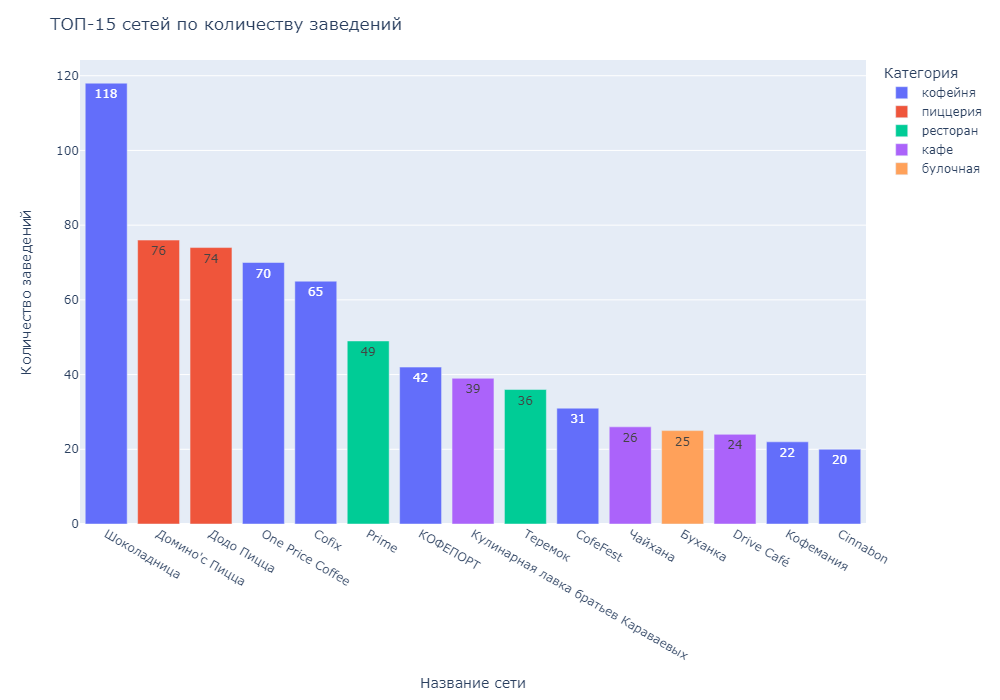

In [66]:
top_15 = top_pivot.sort_values('Число заведений', ascending=False).head(15).reset_index(drop=True)
fig = px.bar(top_15, 
             y='Число заведений', 
             x='Название сети',
             color='Категория',
             text='Число заведений'
            )

fig.update_layout(title='ТОП-15 сетей по количеству заведений',
                   yaxis_title='Количество заведений',
                   xaxis_title='Название сети',
                 width=1000,
                  height=700,
                 xaxis={'categoryorder': 'total descending'})
fig.show("png")

Столбчатая диаграмма весьма наглядно показывает неоспоримое лидерство Шоколадницы в Москве по числу ресторанов.

### Заведения по районам Москвы

Теперь изучим распределение различных заведений по районам Москвы. Причем, сначала мы рассмотрим, как распределены все заведения по районам, а затем рассмотрим их распределение по категориям в каждом районе.

In [67]:
distr = df.pivot_table(index=['district'],values='name',aggfunc='count').reset_index()
distr.columns=['district','count']

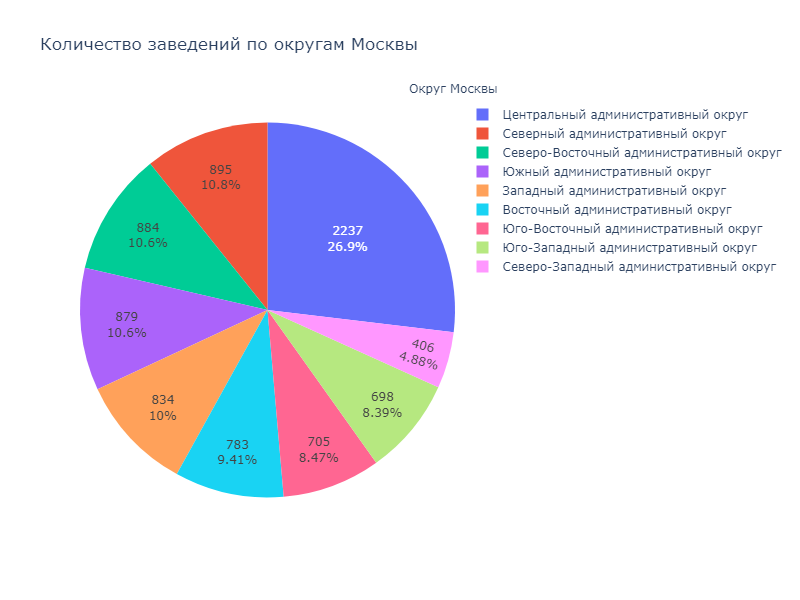

In [68]:
fig = go.Figure(data=[go.Pie(labels=distr['district'], values=distr['count'])])
fig.update_layout(title='Количество заведений по округам Москвы', 
                  width=800, 
                  height=600,
                  annotations=[dict(x=1.12, 
                                    y=1.05,
                                    text='Округ Москвы',
                                    showarrow=False)])
fig.update_traces(textinfo='percent+value')
fig.show("png")

Неудивительно, что в ЦАО чуть больше четверти всех московских заведений. В центре множество офисов, объектов культуры, достопримечательностей, и, конечно же, туристов. А значит, больше всего и спрос на питание. 

Интересно, что меньше всего заведений в СЗАО, хотя, казалось бы, должно быть иначе, поскольку районы недешевые для проживания (кроме Тушино и Куркино, разве что).

На втором месте с конца - ЮЗАО, один из самых дорогих районов Москвы. Здесь находятся крупные ВУЗы (МГУ, МГИМО, РУДН), и, по логике вещей, здесь должно быть больше заведений. Но, видимо, стоимость аренды тоже высока, что накладывает свой отпечаток.

Остальные округа находятся в диапазоне от 700 до 900 заведений на район, что, в принципе, отвечает логике - большинство районов спальные и потребность в заведениях общепита у людей здесь меньше, поскольку бОльшую часть своей жизни они, скорее всего, проводят в ЦАО.

Далее рассмотрим распределение категорий заведений по округам. Можно изобразить это в виде Sunburst диаграммы.

In [69]:
dist_cat = df.pivot_table(index=['district', 'category'],values='name',aggfunc='count').reset_index()
dist_cat.columns=['district','category','count']
dist_cat

,district,category,count
0,Восточный административный округ,"бар,паб",53
1,Восточный административный округ,булочная,25
2,Восточный административный округ,быстрое питание,70
3,Восточный административный округ,кафе,271
4,Восточный административный округ,кофейня,104
...,...,...,...
67,Южный административный округ,кафе,264
68,Южный административный округ,кофейня,131
69,Южный административный округ,пиццерия,73
70,Южный административный округ,ресторан,189


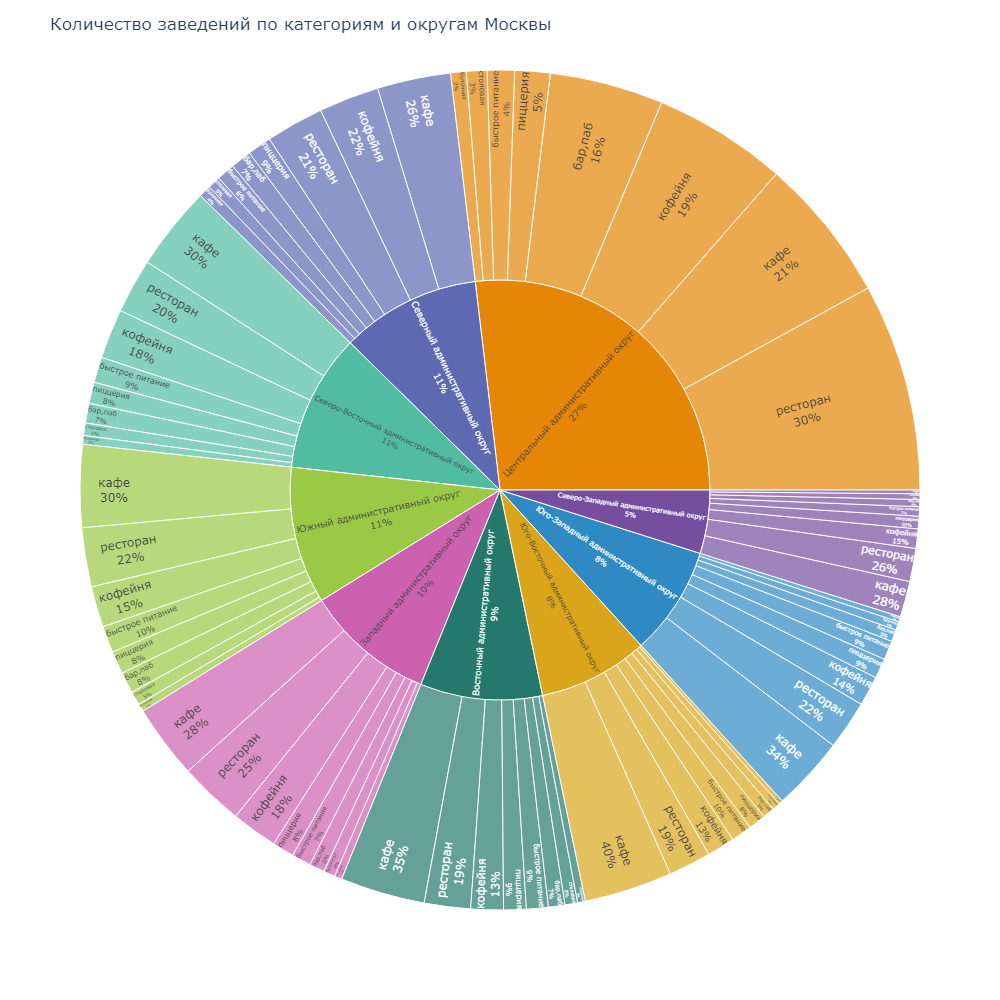

In [70]:
fig = px.sunburst(dist_cat, path=['district', 'category'], values='count', color_discrete_sequence=px.colors.qualitative.Vivid)



fig.update_layout(title='Количество заведений по категориям и округам Москвы',
                  width=1000,
                  height=1000)
fig.update_traces(textinfo='label+percent parent', insidetextorientation='radial')
fig.show("png")

На первый взгляд структура весьма громоздкая, но если нажимать на каждый сектор - можно получать множество отдельных секторных диаграмм по каждому из округов Москвы

Интересно обратить внимание, что почти во всех округах, кроме ЦАО, больше всего кафе - около 30% в каждом округе. На втором и третьем местах - рестораны и кофейни. Это вполне логично: Шоколадница есть практически у каждой станции метро. Так же как и другие сетевые кофейни, главная цель которых - обеспечить вкусным кофе жителей мегаполиса, едущих на работу. Булочных и столовых в каждом округе практически одинаково мало: как правило они распределены по одной булочной на жилой квартал и по одной столовой на микрорайон/предприятие. Интересно, что в САО, СВАО, ВАО, ЮВАО и ЮАО примерно одинаковое число столовых - и это в очередной раз подтверждает, что столовые чаще всего встречаются на предприятиях. Восток и Юг Москвы давно являются одной большой промзоной.

Если рассмотреть более подробно ЦАО - картина будет совершенно иной. Здесь больше всего ресторанов, чуть меньше кафе и кофеен (интересно, что в общем выражении их в округе примерно одинаковое количество), и следом идут бары и пабы. Центр Москвы - очевидно самое привлекательное место чтобы выпить и потанцевать. И эту логику подтверждает количество питейных заведений тут (было бы интересно сравнить с Питером и ответить на вопрос, где же все-таки пить?)

**Резюмируя** исследование распределения заведений по округам Москвы, можно с уверенностью сказать, что в центре города сосредоточено больше всего разнообразных заведений. И в 5 раз больше баров и пабов, чем в любом другом округе Москвы. Центр города нацелен на отдых людей, в том или ином виде, на их питание и красивые ужины. Это обычная логика любого города, где в центре всегда больше всего заведений общественного питания, и чем дальше на окраины, тем меньше этих заведений на пути путешественника.

### Рейтинги по категориям

Для оценки распределения рейтингов заведений по типам, используем диаграмму размаха и изучим ее.

Использовать будем часть датафрейма с названиями, категориями, рейтингом.

In [71]:
rating = df[['name', 'category', 'rating']]
rating.head(10)

,name,category,rating
0,WoWфли,кафе,5.0
1,Четыре комнаты,ресторан,4.5
2,Хазри,кафе,4.6
3,Dormouse Coffee Shop,кофейня,5.0
4,Иль Марко,пиццерия,5.0
5,Sergio Pizza,пиццерия,4.6
6,Огни города,"бар,паб",4.4
7,Mr. Уголёк,быстрое питание,4.7
8,Donna Maria,ресторан,4.8
9,Готика,кафе,4.3


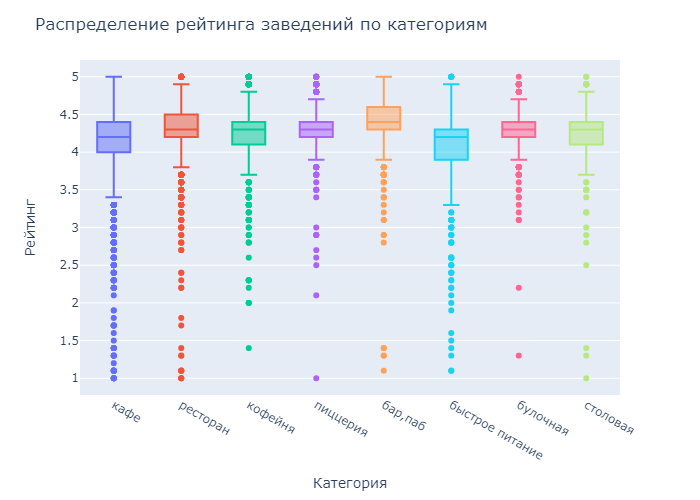

In [72]:
fig = px.box(rating, x="category", y="rating", color='category')
fig.update_layout(title="Распределение рейтинга заведений по категориям",
                  yaxis_title="Рейтинг",
                 xaxis_title="Категория",
                 showlegend=False)
fig.show("png")

На общем графике видно, что у большинства категорий заведений медианный рейтинг находится в промежутке от 4,2 до 4,4 баллов. Также в наличии некоторое количество единичных выбросов в негативе и от 1 до 3 выбросов в позитиве рейтинга.

Весьма интересно, что у пиццерий и булочных разброс рейтинга минимален. Одновременно с этим, и выбросов в сторону максимального балла здесь больше всего, а сами квартили практически идентичны друг другу. Максимальное и минимальное значения здесь также идентичны. Фактически, от пиццерии и булочной, посетитель ожидает примерно одного и того же: типовые хлебобулочные изделия, атмосфера уюта, сытный перекус. Поэтому и пространство для оценки предпочтений здесь минимальное. Скорее всего, поэтому и такой небольшой разброс значений.

Интересно обратить внимание, что у баров самое высокое медианное значение рейтинга - 4,4. Как минимум это означает, что в Москве достаточно много хороших питейных заведений. Практически все они имеют оценку выше 4,0 баллов, а это говорит о том, что уровень барногодела в Москве весьма высок. *Здесь опять же было бы интересно дополнительно сравнить с Питером.*

Интересно, что меньше всего первые квартили у ресторанов, пиццерий, баров и булочных. Вполне обоснованно, учитывая уже описанное выше: пиццерии, булочные и бары в общем и целом отвечают ожидаемому от них, как и рестораны. Это логично: в Москве весьма высок спрос на заведения, и "держать марку" для поддержания себя на уровне жизненно необходимо. При этом, у ресторанов больше третий квартиль - это говорит о том, что чаще всего рестораны будут лучше, чем в среднем от них ожидается. Аналогично и с барами - чаще у них оценки выше медианной, а это значит, что в Москве они также превосходят средние ожидания.

Весьма интересно посмотреть на рейтинги кофеен и кафе. Среди прочих заведений они одни из самых распространенных. Поэтому такой большой разброс оценок. Но при этом не стоит забывать о том, что кафе и кофейни достаточно часто являются стартапами и малым бизнесом, где люди пытаются начать "работать на себя". Возможно, есть резон предположить, что многообразие и разный уровень обслуживания отражаются в разбросе от 4 до 4,4 баллов. 

В части заведений быстрого питания (столовые и быстрое питание вместе) - ввиду их специфики вполне логично, что больше будет оценок ниже медианы. Везде будут недочеты и низкое качество, что повлечет за собой низкие оценки. В принципе, ожидать высоких оценок от "Вкусноточки" и заводской столовой - неразумно.

### Геоаналитика заведений

Проведем анализ геоданных и разместим на карте Москвы отметки заведений.

Построим хороплет с медианным значением рейтинга всех заведений общепита по округам Москвы и изучим его.

In [73]:
moscow_lat, moscow_lng = 55.751244, 37.618423

state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

In [74]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

m

Самый низкий рейтинг у заведений в Восточном административном округе Москвы. Немудрено, здесь по большей части промзоны, и небогатые районы, что накладывает свой отпечаток и на заведения, расположенные в округе.

Но больше интересно, что в СВАО медианный рейтинг самый высокий. Учитывая, что на него приходится всего 11% всех заведений общепита Москвы - можно сказать, что здесь собрались лучшие заведения города.

Низкий рейтинг заведений в ЦАО обусловлен в первую очередь их количеством - разноплановых и разнорейтинговых мест здесь будет больше, поэтому и медианное значение сильно ниже западной и северной частей города.

Остальные округа, в принципе, в своих рейтингах приближены к своим общим характеристикам: дорогие западные районы имеют более высокий рейтинг, чем исторически сложившиеся промзоны в ЮАО и ВАО.

Теперь разместим все точки заведений города на карте и изучим их расположение.

In [75]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['category']}",
    ).add_to(marker_cluster)

df.apply(create_clusters, axis=1)

m

Весьма забавно выглядит одинокое кафе "Кафе" на МКАДе в окрестностях Немчиновки (на самом большом масштабе карты).

Остальные кластеры распределены в соответствии с уже рассматривавшимся распределением заведений по категориям и округам города.

При более близком рассмотрении очевидно, что в лесопарках общепита практически нет (кроме парков, уже прошедших благоустройство: Парк Горького, ЦПКИО Измайлово, Филевский парк и прочие).

Перейдем к исследованию распределения заведений по улицам города: определим 15 самых насыщенных улиц, а также улицы, где есть только одно заведение.

In [76]:
street_pivot = df.pivot_table(index=['street'],values='name',aggfunc='count').reset_index()

Построим столбчатую диаграмму для 15 самых насыщенных улиц

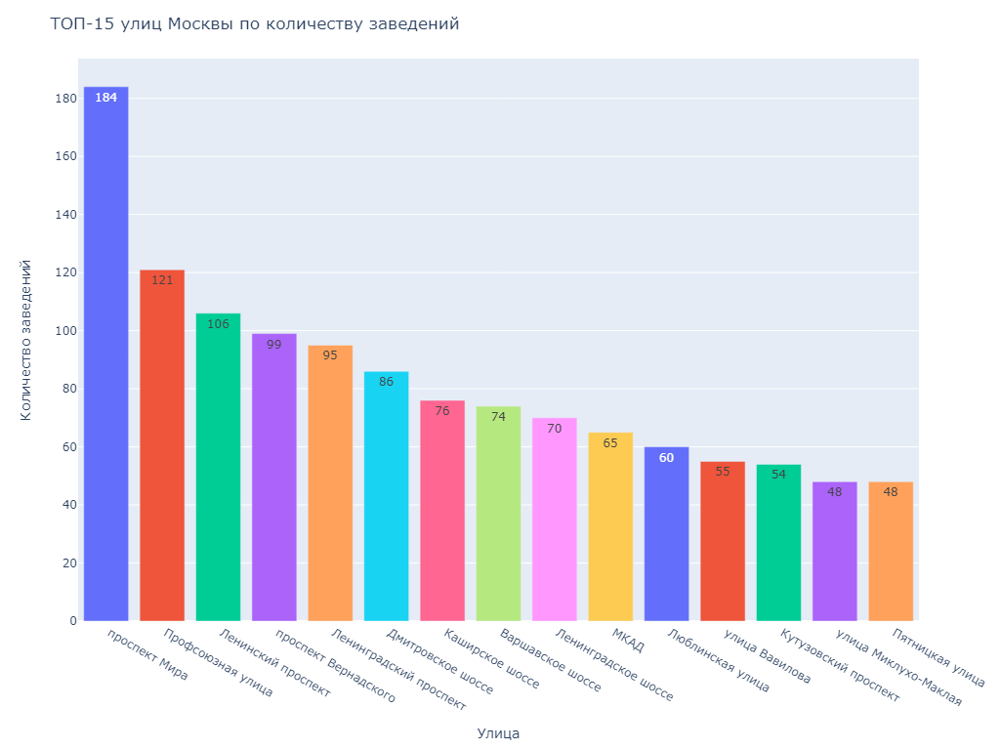

In [77]:
street_15 = street_pivot.sort_values('name', ascending=False).head(15).reset_index(drop=True)
fig = px.bar(street_15, 
             y='name', 
             x='street',
             color='street',
             text='name'
            )

fig.update_layout(title='ТОП-15 улиц Москвы по количеству заведений',
                   yaxis_title='Количество заведений',
                   xaxis_title='Улица',
                  showlegend=False,
                 width=1024,
                  height=768)
fig.show("png")

In [78]:
street_15_f = df[df['street'].isin(street_15['street'])].pivot_table(index=['street','category'],values='name',aggfunc='count').reset_index()

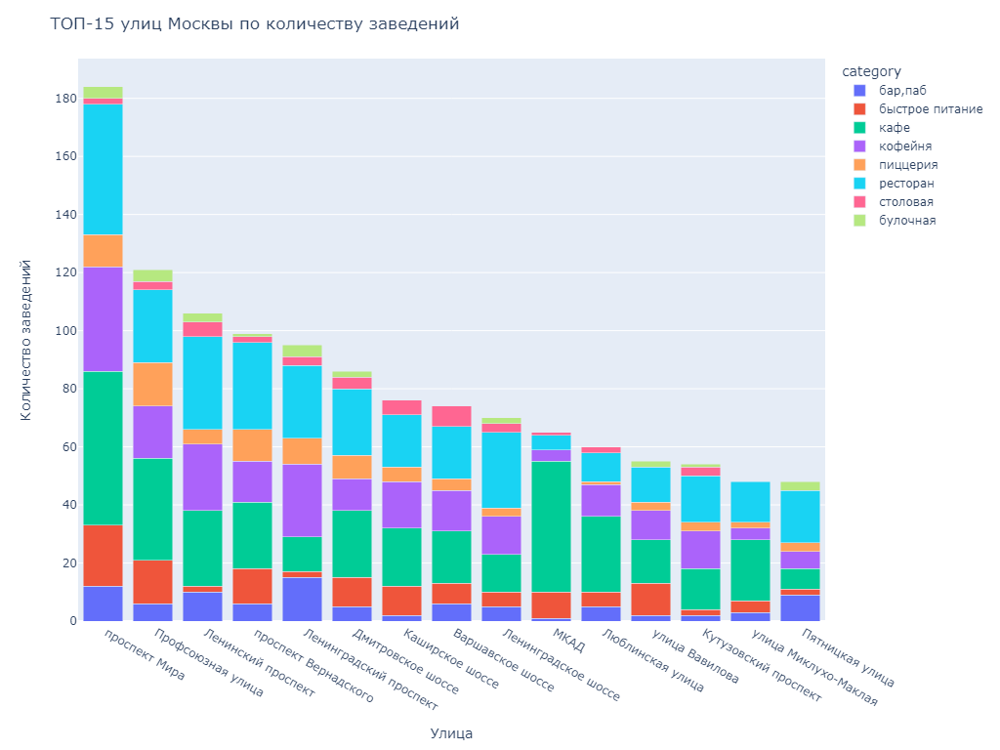

In [79]:
fig = px.bar(street_15_f, 
             y='name', 
             x='street',
             color='category'
            )

fig.update_layout(title='ТОП-15 улиц Москвы по количеству заведений',
                   yaxis_title='Количество заведений',
                   xaxis_title='Улица',
                 width=1024,
                  height=768,
                 barmode='stack', xaxis={'categoryorder':'total descending'})
fig.show("png")

Очень интересно, что больше всего заведений на радиальных магистралях и на МКАДе. Это вполне логично, поскольку данные улицы весьма длинные и по ним всегд перемещается множество людей. А это значит, что потенциальный спрос выше. Весьма интересно, что на МКАДе есть всего один бар, что неудивительно для десятиполосной кольцевой дороги. При этом, кафе там также порядочно, что обусловлено большим количеством транзитных дальнобойщиков, останавливающихся в кафе на перекус.

Ресторанов больше всего на Проспекте Мира, на Ленинском, Ленинградском и Вернадского. Если в случае с Проспектом Мира это обусловлено значительной протяженностью магистрали, то Ленинградка, Ленинский и Вернадка имеют примерно одинаковое количество ресторанов, поскольку магистрали входят в число достаточно "элитных".

Примечательно, что в целом на магистралях примерно отслеживается общая картина распределения категорий заведений, кроме МКАДа, где есть значительный перекос в сторону кафе, что объяснено выше.

Далее выгрузим улицы, где есть только одно заведение.

In [80]:
street_1 = df['street'].value_counts().reset_index()
street_1 = street_1.query('street == 1')
street_1
street_1_f = df[df['street'].isin(street_1['index'])]
street_1_f

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
15,Дом обеда,столовая,"Москва, улица Бусиновская Горка, 2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.885890,37.493264,4.1,средние,Средний счёт:300–500 ₽,400.0,NaN,0,180.0,улица Бусиновская Горка,0.0
21,7/12,кафе,"Москва, Прибрежный проезд, 7",Северный административный округ,"ежедневно, 10:00–22:00",55.876805,37.464934,4.5,NaN,NaN,NaN,NaN,0,NaN,Прибрежный проезд,0.0
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN,парк Левобережный,0.0
58,Coffeekaldi's,кофейня,"Москва, Угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,Средний счёт:500–800 ₽,650.0,NaN,1,NaN,Угличская улица,0.0
60,Чебуречная история,кофейня,"Москва, ландшафтный заказник Лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,NaN,Цена чашки капучино:140–200 ₽,500.0,NaN,1,NaN,ландшафтный заказник Лианозовский,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8281,WTFcoffee,кофейня,"Москва, улица Артюхиной, 14/8с1",Юго-Восточный административный округ,"ежедневно, 10:00–22:00",55.699044,37.737790,4.4,средние,NaN,500.0,NaN,0,NaN,улица Артюхиной,0.0
8300,Red Cafe,ресторан,"Москва, Ферганский проезд, 10Г, стр. 1",Юго-Восточный административный округ,"ежедневно, 12:00–00:00",55.696128,37.821427,4.3,NaN,NaN,NaN,NaN,0,200.0,Ферганский проезд,0.0
8304,Беседка,кафе,"Москва, Кузьминская улица, 10",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690691,37.787735,4.1,NaN,NaN,NaN,NaN,1,NaN,Кузьминская улица,0.0
8366,Лагман Хаус,кафе,"Москва, Новороссийская улица, 14, стр. 2",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.678772,37.759422,4.3,NaN,NaN,NaN,NaN,1,40.0,Новороссийская улица,0.0


Всего 458 заведений, которые являются единственными на той или иной улице.

Для изучения их расположения лучше всего будет расположить их метки на карте и оценить результат.

In [81]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['category']}",
    ).add_to(marker_cluster)

street_1_f.apply(create_clusters, axis=1)

m

Весьма очевидно, что больше всего "одиночных" заведений на улицах Москвы в центре и в пределах Третьего транспортного кольца. Здесь более короткие улицы, иногда тупиковые, большое множество переулков: двум заведениям будет тесно.

В рамках выборки также изучим распределение заведений по категориям и принадлежности к сети.

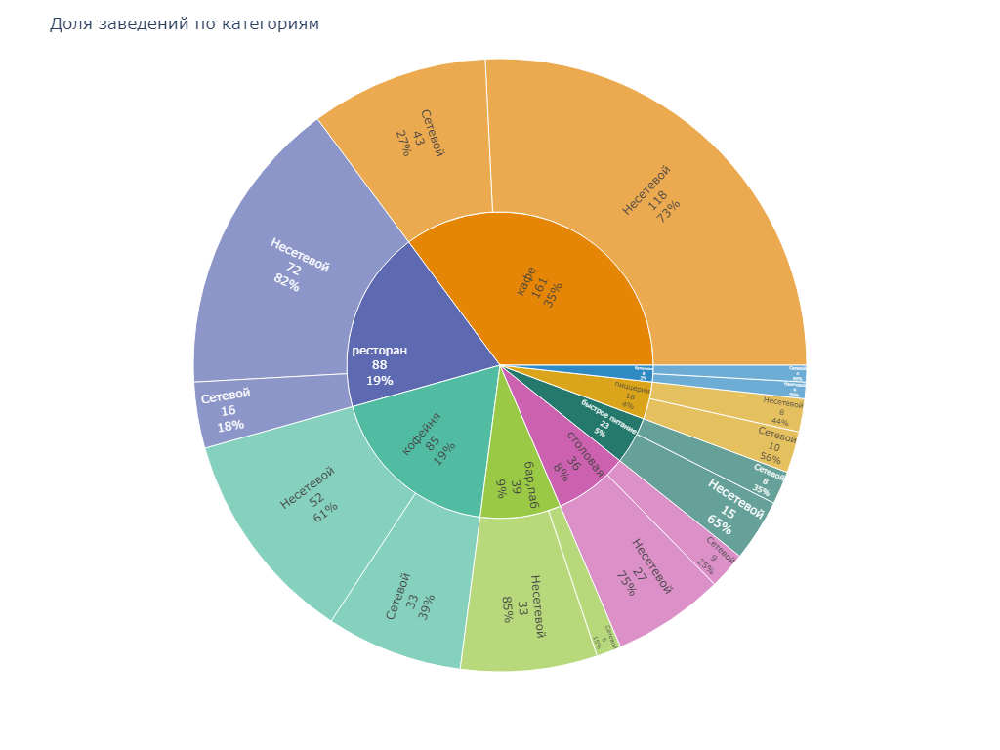

In [82]:
solo_pivot = street_1_f.pivot_table(index=['category', 'chain'], values='name',aggfunc='count').reset_index()
solo_pivot.columns=['category', 'chain', 'count']

def cat_net(row):
    chain = row['chain']
    
    if chain == 1:
        return 'Сетевой'
    else:
        return 'Несетевой'
    
solo_pivot['chn_cat'] = solo_pivot.apply(cat_net, axis=1)

custom_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
fig = px.sunburst(solo_pivot, path=['category', 'chn_cat'], values='count', color_discrete_sequence=px.colors.qualitative.Vivid)



fig.update_layout(title='Доля заведений по категориям',
                  width=1024,
                  height=768)
fig.update_traces(textinfo='label+percent parent+value', insidetextorientation='radial')
fig.show("png")

Интересно, что больше всего одиночных заведений среди кафе, ресторанов и кофеен. Причем около двух третей из них - несетевые. В разрезе кафе и кофеен это снова дает основание предположить, что многие подобные заведения - стартапы людей, начинающих "работать на себя".

Характерно, что сетевых и несетевых булочных всего по 4 одиночных на улице на всю Москву.

В остальном же распределение категорий среди "одиночных" заведений на улицах Москвы практически повторяет общую картину распределения заведений по категориям по всему городу.

### Средние чеки

Исследуем средние чеки в московских заведениях, как в части изучения среднего значения чека для каждой категории, так и в рамках различных округов Москвы. Скорее всего, самые дорогие заведения будут в ЦАО и в западной части города, а самые дешевые - в восточной и южной частях.

In [83]:
avg_bill = df.query('(middle_avg_bill != 0) & (middle_avg_bill.notna())').reset_index(drop=True)

avg_bill_pivot = avg_bill.pivot_table(index=['district'],values='middle_avg_bill',aggfunc='mean').reset_index()

In [84]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=avg_bill_pivot,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний счет заведений по районам',
).add_to(m)

m

Если сопоставить карту среднего счета по округу с картой среднего рейтинга по округу, получится, что в СВАО самые дешевые и самые рейтинговые заведения в Москве. Определенно, стоит на них обратить внимание.

Также, как предполагалось выше, в ЦАО самые дорогие заведения. в САО и ЗАО - чуть дешевле, но тоже на высоком уровне, что также обусловлено определенной "элитностью" этих направлений.

В то же самое время, заведения в ЮВАО и ВАО одни из самых дешевых, также как и одни из самых низкорейтинговых. Это также понятно: East-end всегда является промышленной окраиной, и здесь живут рабочие, здесь множество заводов и т.п.

**Конечный вывод** из полученных данных в очередной раз подтверждает, что все самые дорогие места в Москве - в центре и на западе. А на прочих окраинах города, где больше промзон и дешевле жилье - аналогично дешевле и заведения. Общеизвестный факт о дороговизне отдельных районов Москвы выражается и в срежних чеках заведений - как правило в них закладывается еще и некая доля арендной платы.

Исследование было бы неполным, если не изучить данные о средних чеках по каждой из категорий заведений и сопоставить их в рейтингами данных заведений. Рассмотрим заведения в порядке уменьшения их количества в городе от большего к меньшему.

#### Кафе

In [85]:
cafe_bill = df.query('(middle_avg_bill != 0) & (middle_avg_bill.notna()) & (category == "кафе")').reset_index(drop=True)
cafe_bill_pivot = cafe_bill.pivot_table(index=['district'],values='middle_avg_bill',aggfunc='mean').reset_index()

In [86]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=cafe_bill_pivot,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний счет кафе по районам',
).add_to(m)

m

In [87]:
cafe_rating = df.query('category == "кафе"').reset_index(drop=True)
cafe_rating_pivot = cafe_rating.pivot_table(index=['district'],values='rating',aggfunc='median').reset_index()

In [88]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=cafe_rating_pivot,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

m

Самые дорогие и самые лучшие среди равных кафе - в центре, а по соотношению цена-качество (предполагая, что рейтинг отражает качество заведения), в лидерах - кафе САО. Весьма интересный результат, особенно в свете тяги лучших заведений к центру города.

#### Рестораны

In [89]:
rest_bill = df.query('(middle_avg_bill != 0) & (middle_avg_bill.notna()) & (category == "ресторан")').reset_index(drop=True)
rest_bill_pivot = rest_bill.pivot_table(index=['district'],values='middle_avg_bill',aggfunc='mean').reset_index()

In [90]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=rest_bill_pivot,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний счет ресторанов по районам',
).add_to(m)

m

In [91]:
rest_rating = df.query('category == "ресторан"').reset_index(drop=True)
rest_rating_pivot = rest_rating.pivot_table(index=['district'],values='rating',aggfunc='median').reset_index()

In [92]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=rest_rating_pivot,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг ресторанов по районам',
).add_to(m)

m

Самые дорогие рестораны, очевидно, находятся в ЦАО: на цену здесь в немалой степени влияет стоимость аренды помещений, а также общая атмосфера элитности района. Далее идут рестораны в ЗАО и САО, что тоже неудивительно: Рублевка, Кутузовский и Ленинградка - также весьма "статусные" магистрали. Самые дешевые же, как и ожидается, в ЮАО и ЮВАО, где расположено множество промзон. Районы недорогие в части аренды, и имеют невысокую покупательную способность населения.

Что касается рейтингов, в лидерах исключительно ЦАО, а все остальные наравне. Что тоже логично, поскольку для выживания ресторану в центре города нужно быть не только дорогим, но и качественным. Опять же, если проводить полевое исследование, то откровенно плохие заведения в центре Москвы окажутся весьма редкими и специфичными.

#### Кофейни

In [93]:
coffee_bill = df.query('(middle_avg_bill != 0) & (middle_avg_bill.notna()) & (category == "кофейня")').reset_index(drop=True)
coffee_bill_pivot = coffee_bill.pivot_table(index=['district'],values='middle_avg_bill',aggfunc='mean').reset_index()

In [94]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=coffee_bill_pivot,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний счет кофеен по районам',
).add_to(m)

m

In [95]:
coffee_rating = df.query('category == "кофейня"').reset_index(drop=True)
coffee_rating_pivot = coffee_rating.pivot_table(index=['district'],values='rating',aggfunc='median').reset_index()

In [96]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=coffee_rating_pivot,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг кофеен по районам',
).add_to(m)

m

По ценам кофейни примерно идентичны ресторанам: ценовая политика в принципе повторяет разницу в стоимости аренды. Но по рейтингам оказывается, что в ЗАО медианный рейтинг ниже всех остальных округов. То есть, за ту же цену потребитель получает менее качественный продукт. Данный перекос может быть вызван как привередливостью публики, так и невозможностью дать более качественный продукт за меньшую стоимость, что напрямую отразится на доходности заведения.

#### Бары и пабы

In [97]:
bar_bill = df.query('(middle_avg_bill != 0) & (middle_avg_bill.notna()) & (category == "бар,паб")').reset_index(drop=True)
bar_bill_pivot = bar_bill.pivot_table(index=['district'],values='middle_avg_bill',aggfunc='mean').reset_index()

In [98]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=bar_bill_pivot,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний счет баров и пабов по районам',
).add_to(m)

m

In [99]:
bar_rating = df.query('category == "бар,паб"').reset_index(drop=True)
bar_rating_pivot = bar_rating.pivot_table(index=['district'],values='rating',aggfunc='median').reset_index()

In [100]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=bar_rating_pivot,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг баров и пабов по районам',
).add_to(m)

m

Бары и пабы, как и прочие заведения, в ЦАО и ЗАО самые дорогие. Это неудивительно: здесь множество как простых баров, так и дорогих клубов, где подают алкоголь. Эти заведения не только дороги, но и популярны. А высокий средний чек вместе с не менее высоким рейтингом относительно остальных округов, говорят о том, что посетители любят задерживаться в таких местах.

Север и северо-восток города в рейтингах ниже, что объясняется сосредоточением хороших заведений в другой части города, но по соотношению цена-качество САО, как и в случае с кафе, находится в  выигрышной позиции.

#### Пиццерии

In [101]:
pizza_bill = df.query('(middle_avg_bill != 0) & (middle_avg_bill.notna()) & (category == "пиццерия")').reset_index(drop=True)
pizza_bill_pivot = pizza_bill.pivot_table(index=['district'],values='middle_avg_bill',aggfunc='mean').reset_index()

In [102]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=pizza_bill_pivot,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний счет пиццерий по районам',
).add_to(m)

m

In [103]:
pizza_rating = df.query('category == "пиццерия"').reset_index(drop=True)
pizza_rating_pivot = pizza_rating.pivot_table(index=['district'],values='rating',aggfunc='median').reset_index()

In [104]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=pizza_rating_pivot,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг пиццерий по районам',
).add_to(m)

m

Пиццерии, как и прочие заведения, в ценовой политике следуют разнице арендной платы по районам. В части рейтингов, снова, самые лучшие - в центре. Но и остальные округа, в общем, не отстают и держат достаточно высокую планку.

#### Быстрое питание

In [105]:
fast_bill = df.query('(middle_avg_bill != 0) & (middle_avg_bill.notna()) & (category == "быстрое питание")').reset_index(drop=True)
fast_bill_pivot = fast_bill.pivot_table(index=['district'],values='middle_avg_bill',aggfunc='mean').reset_index()

In [106]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=fast_bill_pivot,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний счет заведений по районам',
).add_to(m)

m

In [107]:
fast_rating = df.query('category == "быстрое питание"').reset_index(drop=True)
fast_rating_pivot = fast_rating.pivot_table(index=['district'],values='rating',aggfunc='median').reset_index()

In [108]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=fast_rating_pivot,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг фастфуда по районам',
).add_to(m)

m

Фастфуд демонстрирует диаметрально противоположную картину относительно остальных заведений. Наибольший средний чек на востоке и в центре. Но здесь, учитывая, что в фастфуде как правило единая ценовая политика, огромную роль играет, в случае с ЦАО, большое количество "транзитных" посетителей (туристы, офисные работники, студенты), а в случае с ВАО - наличие множества спальных районов с невысокими ценами на жилье, а значит - огромное количество гастарбайтеров и простых работяг, имеющих большие семьи, которые питаются в подобных заведениях. В принципе, такое распределение логично для самой сути фастфуда.

#### Столовые

In [109]:
canteen_bill = df.query('(middle_avg_bill != 0) & (middle_avg_bill.notna()) & (category == "столовая")').reset_index(drop=True)
canteen_bill_pivot = canteen_bill.pivot_table(index=['district'],values='middle_avg_bill',aggfunc='mean').reset_index()

In [110]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=canteen_bill_pivot,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний счет столовых по районам',
).add_to(m)

m

In [111]:
canteen_rating = df.query('category == "столовая"').reset_index(drop=True)
canteen_rating_pivot = canteen_rating.pivot_table(index=['district'],values='rating',aggfunc='median').reset_index()

In [112]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=canteen_rating_pivot,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг столовых по районам',
).add_to(m)

m

Столовые весьма интересны тем, что на западе города в них самый высокий чек. Учитывая, что в этом округе находятся несколько крупных элитных ВУЗов, министерств и посольств, которые имеют свои столовые (зачастую закрытые для посетителей "с улицы", но безальтернативных для "местных" жителей), логично, что люди будут оставлять здесь больше денег.

Но одновременно с этим, лучшие по рейтингу столовые находятся в ЦАО, ЮАО и ВАО. Если первое обсуловлено отчасти исторически сложившимся высоким качеством заведений (здесь еще больше министерств и ФОИВов), то два других округа, будучи промзонами, держат высокую планку за счет наличия своих столовых на предприятиях.

#### Булочные

In [113]:
bulka_bill = df.query('(middle_avg_bill != 0) & (middle_avg_bill.notna()) & (category == "булочная")').reset_index(drop=True)
bulka_bill_pivot = bulka_bill.pivot_table(index=['district'],values='middle_avg_bill',aggfunc='mean').reset_index()

In [114]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=bulka_bill_pivot,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний счет булочных по районам',
).add_to(m)

m

In [115]:
bulka_rating = df.query('category == "булочная"').reset_index(drop=True)
bulka_rating_pivot = bulka_rating.pivot_table(index=['district'],values='rating',aggfunc='median').reset_index()

In [116]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=bulka_rating_pivot,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг булочных по районам',
).add_to(m)

m

С булочными, как и с пиццериями, на высокий средний чек в ЦАО влияет арендная плата, но также и наличие различных пекарен "старой Москвы", где дорого и вкусно.

С рейтингами же еще интереснее: если в центре, по сути, все объясняется исторически сложившимися обстоятельствами и рынком (заведения конкурируют друг с другом за посетителя, и тем самым стараются держать марку не хуе чем у конкурентов), то в ЮАО высокий рейтинг может быть вполне обусловлен не менее высоким качеством продукции, нежели чем в других округа, где количество заведений примерно аналогично.

### Дополнительные факторы

Считается, что Москва - это город, который не спит, и найти круглосуточные заведения можно любые и в любом районе города. Поэтому детально рассмотрим часы работы заведений, а также, какие заведения могут так работать в городе.

Для начала рассмотрим в общем виде, какого типа заведения встречаются с различными часами работы.

In [117]:
hrs = df.pivot_table(index='hours', values='name', aggfunc='count').sort_values('name', ascending=False).reset_index()
hrs

,hours,name
0,"ежедневно, 10:00–22:00",758
1,"ежедневно, круглосуточно",721
2,"ежедневно, 11:00–23:00",396
3,"ежедневно, 10:00–23:00",309
4,"ежедневно, 12:00–00:00",254
...,...,...
1300,"пн-пт 08:30–20:30; сб,вс 09:30–19:30",1
1301,"пн-пт 08:30–20:30; сб,вс 10:00–21:00",1
1302,пн-пт 08:30–21:00,1
1303,"пн-пт 08:30–21:00; сб,вс 09:00–22:00",1


Всего 1305 различных записей, поэтому ограничим исследование самыми часто встречающимися 15-ю записями.

In [118]:
hrs_15 = hrs.sort_values('name', ascending=False).head(15).reset_index()
hrs_15

,index,hours,name
0,0,"ежедневно, 10:00–22:00",758
1,1,"ежедневно, круглосуточно",721
2,2,"ежедневно, 11:00–23:00",396
3,3,"ежедневно, 10:00–23:00",309
4,4,"ежедневно, 12:00–00:00",254
5,5,"ежедневно, 09:00–21:00",204
6,6,"ежедневно, 09:00–22:00",184
7,7,"ежедневно, 12:00–23:00",178
8,8,"ежедневно, 08:00–23:00",159
9,9,"ежедневно, 08:00–22:00",148


In [119]:
sum(hrs_15['name'])

3849

В дальнейшем исследовании будут участвовать только 3849 заведений из всех имеющихся в наборе данных. Это немалое количество, поэтому, в общих чертах, выборка будет репрезентативна.

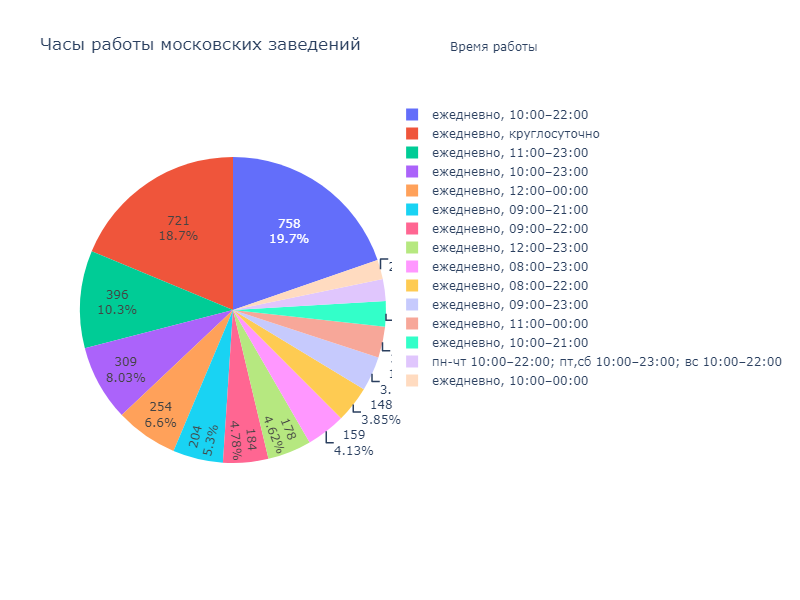

In [120]:
fig = go.Figure(data=[go.Pie(labels=hrs_15['hours'], values=hrs_15['name'])])
fig.update_layout(title='Часы работы московских заведений', 
                  width=800, 
                  height=600,
                  annotations=[dict(x=1.50, 
                                    y=1.15,
                                    text='Время работы',
                                    showarrow=False)])
fig.update_traces(textinfo='percent+value')
fig.show("png")

В полученной выборке все заведения работают ежедневно, но открываются и закрываются в разное время. Примечательно, что 18,7% из отобранных заведений - круглосуточные. Это немалое количество, поэтому можем рассмотреть, в каких районах города наиболее часто встречаются подобные места, и к какой категории они принадлежат.

In [121]:
night = df.query('hours=="ежедневно, круглосуточно"').reset_index(drop=True)
night

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,Great Room Bar,"бар,паб","Москва, Левобережная улица, 12",Северный административный округ,"ежедневно, круглосуточно",55.877832,37.469171,4.5,средние,Цена бокала пива:250–350 ₽,500.0,NaN,0,102.0,Левобережная улица,1.0
1,Чайхана Беш-Бармак,ресторан,"Москва, Ленинградское шоссе, 71Б, стр. 2",Северный административный округ,"ежедневно, круглосуточно",55.876908,37.449876,4.4,средние,Средний счёт:350–500 ₽,425.0,NaN,0,96.0,Ленинградское шоссе,1.0
2,Пекарня,булочная,"Москва, Ижорский проезд, 5",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,1,NaN,Ижорский проезд,1.0
3,Drive Café,кафе,"Москва, улица Дыбенко, 9Ас1",Северный административный округ,"ежедневно, круглосуточно",55.879992,37.481571,4.0,NaN,NaN,NaN,NaN,1,NaN,улица Дыбенко,1.0
4,2U-Ту-Ю,пиццерия,"Москва, Ижорская улица, 8А",Северный административный округ,"ежедневно, круглосуточно",55.886160,37.508784,2.7,NaN,Средний счёт:900 ₽,900.0,NaN,0,NaN,Ижорская улица,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
716,Намангале,кафе,"Москва, Ферганская улица, вл17-21",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.705332,37.819244,4.3,NaN,NaN,NaN,NaN,0,NaN,Ферганская улица,1.0
717,"Пекарня, кафе-гриль",булочная,"Москва, Болотниковская улица, 52, корп. 2",Юго-Западный административный округ,"ежедневно, круглосуточно",55.662866,37.582572,4.2,NaN,Средний счёт:50–250 ₽,150.0,NaN,0,50.0,Болотниковская улица,1.0
718,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0,Люблинская улица,1.0
719,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,Средний счёт:150–350 ₽,250.0,NaN,1,150.0,Люблинская улица,1.0


In [122]:
night_rating_pivot = night.pivot_table(index=['district'],values='rating',aggfunc='median').reset_index()
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth(
    geo_data=state_geo,
    data=night_rating_pivot,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг круглосуточных заведений по районам',
).add_to(m)

m

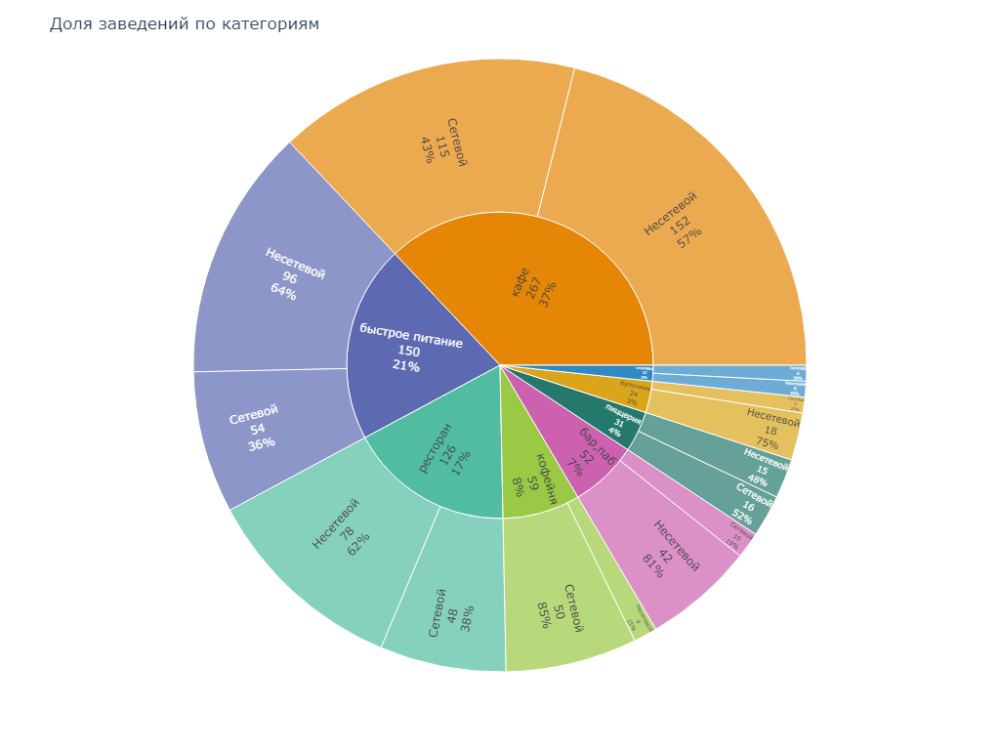

In [123]:
night_pivot = night.pivot_table(index=['category', 'chain'], values='name',aggfunc='count').reset_index()
night_pivot.columns=['category', 'chain', 'count']

def cat_net(row):
    chain = row['chain']
    
    if chain == 1:
        return 'Сетевой'
    else:
        return 'Несетевой'
    
night_pivot['chn_cat'] = night_pivot.apply(cat_net, axis=1)

custom_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
fig = px.sunburst(night_pivot, path=['category', 'chn_cat'], values='count', color_discrete_sequence=px.colors.qualitative.Vivid)



fig.update_layout(title='Доля заведений по категориям',
                  width=1024,
                  height=768)
fig.update_traces(textinfo='label+percent parent+value', insidetextorientation='radial')
fig.show("png")

In [124]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['category']}",
    ).add_to(marker_cluster)

night.apply(create_clusters, axis=1)

m

In [125]:
night_all = night.pivot_table(index=['district'], values='name',aggfunc='count').reset_index()
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth(
    geo_data=state_geo,
    data=night_all,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество круглосуточных заведений по районам',
).add_to(m)

m

In [126]:
night_bill = df.query('(middle_avg_bill != 0) & (middle_avg_bill.notna()) & (hours == "ежедневно, круглосуточно")').reset_index(drop=True)
night_bill_pivot = night_bill.pivot_table(index=['district'],values='middle_avg_bill',aggfunc='mean').reset_index()
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth(
    geo_data=state_geo,
    data=night_bill_pivot,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний счет круглосуточных заведений по районам',
).add_to(m)

m

Полученные данные интересны тем, что больше всего круглосуточных заведений находится в ЦАО. Самые рейтинговые и самые дорогие заведения - там же. Снова это подтверждает уже выдвигавшиеся ранее тезисы о том, что самые лучшие заведения сосредоточены в центре города. Здесь оживленная ночная жизнь, множество туристов и красивые виды.

Более половины этих заведений - кафе и фастфуд, что также немудрено: ночью наступает время быстрого перекуса на пути между увеселительными заведениями, по пути с работы. Общая картина круглосуточных заведений значительно отличается от полной ситуации, выводя на первый план именно скорость подачи блюд и их простоту в кафе и фастфудах. При этом, рестораны все равно остаются в топ-3 по распространению, а это значит, что на их услуги есть определенный спрос. 

Одновременно с этим, в "окраинных" районах картина следующая: на "рабочем" востоке круглосуточных заведений больше, но их цены ниже, и рейтинг также ниже. Это вполне очевидно: живущие здесь мигранты и рабочие могут работать на двух работах, возвращаться поздно со смены, и подобные заведения всегда будут к месту.

В то же время, более "дорогой" запад Москвы имеет меньше круглосуточных заведений, они несколько дороже своих восточных "братьев", но примерно настолько же более качественные, если считать рейтинг мерилом качества.

В общих чертах, картина в круглосуточных заведениях аналогична всем остальным уже проведенным исследованиям: восток более дешев и имеет более низкий рейтинг, чем запад; центр же, в свою очередь, сосредоточил в себе всё самое дорогое и качественное, что в немалой степени обусловлено стоимостью аренды в данном округе, но также и статусом нахождения в сердце столицы.

### Выводы

Проведенное исследование показало, что в Москве весьма многогранный и насыщенный рынок общественного питания. При общем количестве заведений более 8 тысяч, практически половину из них составляют кафе и рестораны, из которых по две трети от каждого вида не принадлежат к какой-либо сети. Больше всего сетевых заведений среди всех по Москве - у пиццерий и кофеен. Такое распределение весьма логично: если рестораны и кафе, а также бары и пабы, являются чаще всего заведениями индивидуальными и специфически направленными, их основной экономический фокус и маркетинг и сосредоточен на своей уникальности и самостоятельности. Пиццерии и кофейни, будучи часто заведениями либо с доставкой, либо типа "coffee-to-go", будут более экономически выгодны именно в сетевом формате, когда массовость продукта уменьшает издержки на его производство, позволяя достичь большей экономической эффективности. Весьма интересно, что среди общепита только четверть - сетевые, а это означает, что не "Вкусноточкой" единой жив москвич. Обилие лавочек с шаурмой и прочим стритфудом действительно заметно на улицах города.

Для различных районов города, а также сложившегося исторически в европейских столицах деления на West-end и East-end, характерно и различное количество разного типа заведений. В восточных округах находятся более дешевые и более массовые заведения, рассчитанные на неприхотливого посетителя, который как правило живет в этих районах. Центр, запад и юго-запад города, как самые дорогие районы, также имеет более дорогие и более высокоуровневые заведения, где местная и приезжая искушенная публика будет оставлять свои деньги. При этом, характерно, что только в ЦАО 1/3 всех заведений - рестораны, в том время как в остальных округах место ресторанов занимают кафе. Учитывая солидный возраст города и определенную красоту исторического центра, подобное распределение также очевидно: ужин в ресторане, находящемся в историческом здании будет намного более востребован, чем ужин в ресторане, находящемся среди спального района.

В Москве около 10% всех заведений - круглосуточные, что говорит как минимум о том, что город всё же иногда спит.
При этом, их распространенность по всем районам города кроме центра, средние чеки и рейтинги совпадают с историческим делением города на "богатую" и "небогатую" части.

Общая картина такова, что тип, рейтинг и средний чек заведения будут напрямую зависеть от места расположения самого заведения, а также от статусности этого самого места. При этом, максимальная конкуренция будет в ЦАО, где на эффективность заведения будет влиять не только обилие выбора у потребителя, но также и высокий рейтинг конкурентов, большое их количество и разнообразие, высокие цены на аренду помещений и ограниченность пространства. Однако именно здесь есть бОльшая вероятность открыть (при наличии стартового капитала для аренды) успешное самобытное заведение, которое так или иначе окупится ввиду значительного количества работающих, учащихся и путешествующих в историческом центре Москвы. Окраины же будут требовательны не только к уровню цен и качеству заведения, но и к его категории: навряд ли находящийся в промзоне ресторан будет восприниматься адекватно своему статусу, и иметь достаточно посетителей, чтобы хоть раз показать полную посадку.

## Детализированное исследование

Основателям фонда «Shut Up and Take My Money» не даёт покоя успех сериала «Друзья». Их мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве. Будем считать, что заказчики не боятся конкуренции в этой сфере, ведь кофеен в больших городах уже достаточно. В исследовании необходимо будет оценить общий рынок в городе, особенности заведений, их расположение.

По результатам исследования ожидаются рекомендации по открытию нового заведения: место расположения, ценовая политика, часы работы и прочее.

*Ремарка*

Обратим внимание на то, что Заказчику не требуется тематическое кафе, поскольку таких в Москве целых три штуки: https://friendsmsk.ru/united_delights?utm_source=friendsmsk

Поэтому основную цель можно переформулировать как "Требуются рекомендации по открытию популярной и успешной кофейни в Москве".

Для начала сформируем датасет только для московских кофеен со всеми имеющимися у нас данными.

In [127]:
coffee = df.query('category == "кофейня"').reset_index(drop=True)
coffee

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,0.0
1,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN,парк Левобережный,0.0
2,9 Bar Coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,Цена чашки капучино:115–140 ₽,NaN,NaN,1,46.0,Коровинское шоссе,0.0
3,CofeFest,кофейня,"Москва, улица Маршала Федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,Цена чашки капучино:90–100 ₽,500.0,NaN,1,NaN,улица Маршала Федоренко,0.0
4,Cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,Цена чашки капучино:от 60 ₽,180.0,NaN,1,NaN,улица Дыбенко,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1405,Назис Пури,кофейня,"Москва, Люблинская улица, 61",Юго-Восточный административный округ,"ежедневно, 09:00–22:00",55.684103,37.738588,4.5,NaN,NaN,NaN,NaN,0,NaN,Люблинская улица,0.0
1406,Квадрат кофе,кофейня,"Москва, Волгоградский проспект, 73, стр. 1",Юго-Восточный административный округ,"пн-пт 08:30–21:30; сб,вс 09:00–21:30",55.709710,37.744450,4.2,NaN,Цена чашки капучино:100–220 ₽,NaN,160.0,0,206.0,Волгоградский проспект,0.0
1407,Шоколад имбирь корица,кофейня,"Москва, Грайвороновская улица, 23",Юго-Восточный административный округ,пн-пт 09:30–19:30,55.721213,37.740755,4.1,NaN,NaN,NaN,NaN,0,NaN,Грайвороновская улица,0.0
1408,Cafio,кофейня,"Москва, Новохохловская улица, 49",Юго-Восточный административный округ,"пн-пт 07:00–22:00; сб,вс 07:00–21:00",55.724357,37.716415,4.7,NaN,Цена чашки капучино:80–120 ₽,NaN,100.0,0,NaN,Новохохловская улица,0.0


Итого 1410 различных значений, весьма значительный датасет для исследования.

### Конкуренты по районам Москвы

В первую очередь оценим конкуренцию по районам Москвы: построим диаграмму с распределением кофеен по округам города, оценим средний чек, построим на карте маркеры с расположением заведений. Часть исследования уже проводилась выше, поэтому воспользуемся имеющимися заготовками и дополним их новыми данными.

In [128]:
cof_dst = coffee.pivot_table(index='district', values='name',aggfunc='count').reset_index()

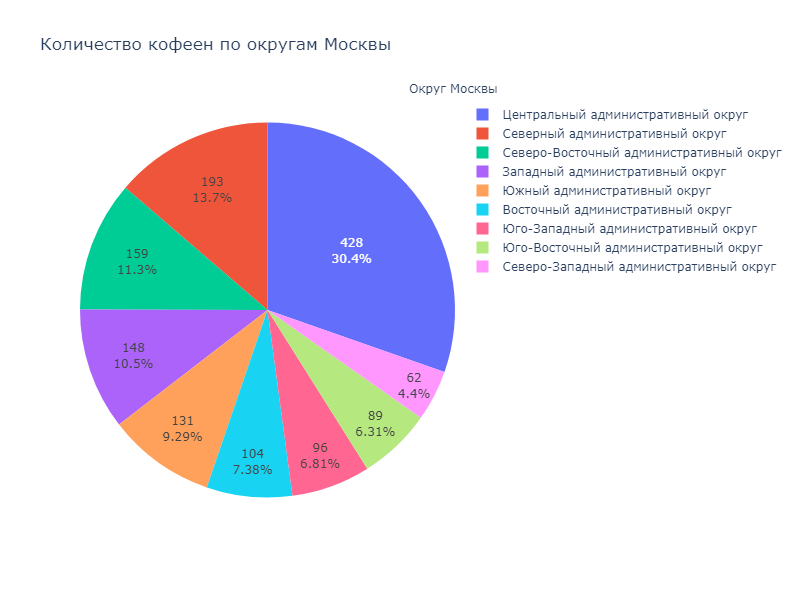

In [129]:
fig = go.Figure(data=[go.Pie(labels=cof_dst['district'], values=cof_dst['name'])])
fig.update_layout(title='Количество кофеен по округам Москвы', 
                  width=800, 
                  height=600,
                  annotations=[dict(x=1.12, 
                                    y=1.05,
                                    text='Округ Москвы',
                                    showarrow=False)])
fig.update_traces(textinfo='percent+value')
fig.show("png")

Практически треть всех кофеен в Москве находятся в ЦАО.

При этом, меньше всего их в СЗАО, ЮВАО и ЮЗАО. Если в части ЮВАО ситуация объясняется обилием промзон и малой целевой аудиторией кофеен, то в СЗАО и ЮЗАО основное влияние оказывает элитность этих районов и высокая цена аренды, а также более высокий общий уровень достатка населения. 

Для большей наглядности построим хороплет с распределением количества кофеен по округам Москвы.

In [130]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=cof_dst,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество кофеен по районам',
).add_to(m)

m

Нанесем на карту точки кофеен и более внимательно посмотрим на характер их расположения. Скорее всего, большая концентрация будет наблюдаться в торговых центрах, возле офисных кварталов, а также в районе достопримечательностей и крупных магистралей.

In [131]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['category']}",
    ).add_to(marker_cluster)

coffee.apply(create_clusters, axis=1)

m

При приближении карты видно, что кофейни действительно в основном расположены в местах потенциально большого скопления людей. Практически в каждом торговом центре есть как минимум одна кофейня. Также, возле крупных бизнес-центров, а порой и в них, также есть по одной кофейне.

Заведения находятся в шаговой доступности от министерств, больниц, отдельных крупных жилых комплексов. Есть они и возле многих станций метро. Соответственно, основной приоритет их расположения - в местах скопления потенциальных клиентов, а также с хорошей транспортной доступностью.

*Сетевой фактор*

Отдельно коротко рассмотрим соотношение сетевых и несетевых заведений в целевой выборке.

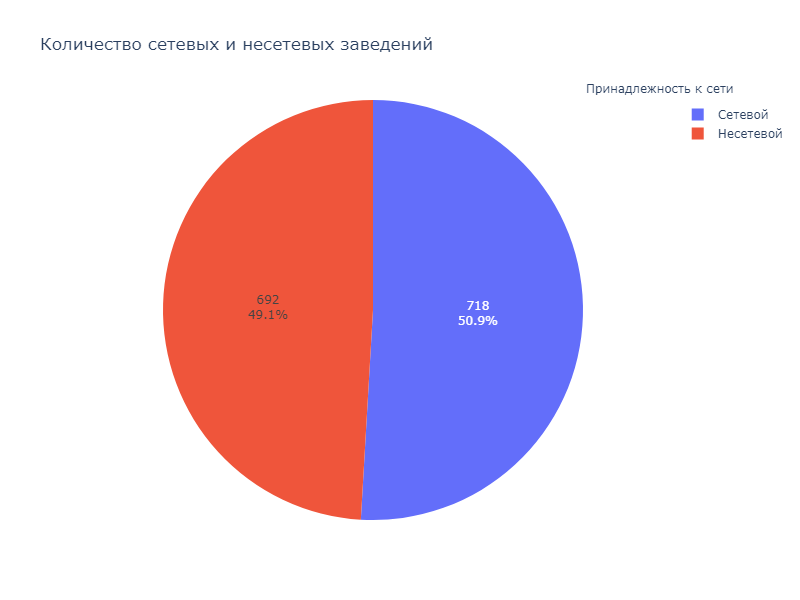

In [132]:
cf_chn = coffee.pivot_table(index='chain',values='name',aggfunc='count').reset_index()
cf_chn.columns=['chain','count']
def cat_net(row):
    chain = row['chain']
    
    if chain == 1:
        return 'Сетевой'
    else:
        return 'Несетевой'
    
cf_chn['chn_cat'] = cf_chn.apply(cat_net, axis=1)

fig = go.Figure(data=[go.Pie(labels=cf_chn['chn_cat'], values=cf_chn['count'])])
fig.update_layout(title='Количество сетевых и несетевых заведений', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600,
                  annotations=[dict(x=1.12, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Принадлежность к сети',
                                    showarrow=False)])
fig.update_traces(textinfo='percent+value')
fig.show("png")

Сетевых и несетевых заведений приблизительно поровну, поэтому можно сделать вывод, что фактор сети в разрезе кофеен в Москве не так уж и важен.

*Посадочные места*

Рассмотрим, какое количество посадочных мест характерно для московских кофеен.

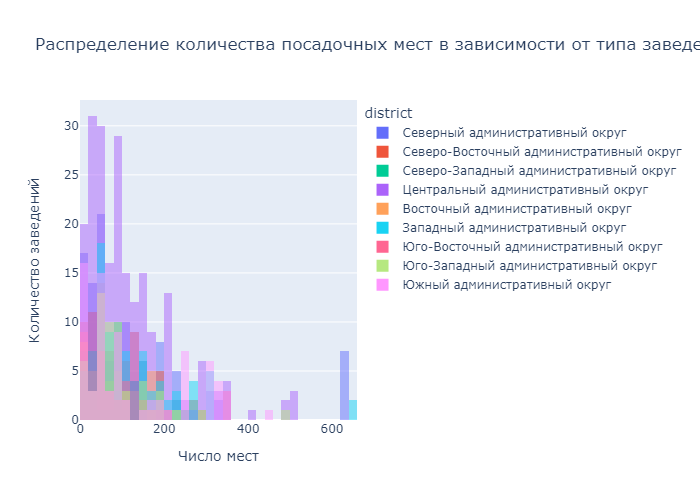

In [133]:
fig = px.histogram(coffee,
                   x='seats', 
                   color='district', 
                   title='Распределение количества посадочных мест в зависимости от типа заведения',  
                   barmode='overlay') 
fig.update_xaxes(title_text='Число мест') 
fig.update_yaxes(title_text='Количество заведений') 
fig.show("png") 

Данный интерактивный график впоследствии используем при формировании вывода о том, какое количество посадочных мест может быть в кафе Заказчика в зависимости от выбранного места расположениия.

### Часы работы

Ранее мы уже рассматривали часы работы московских заведений общественного питания и увидели, что различных вариантов великое множество.

Однако, учитывая, что кофейня - заведение более-менее стандартизированное, можно предположить, что и часы работы будут стандартные, но и не без отдельных "выбросов".

In [134]:
cf_hrs = coffee.pivot_table(index='hours', values='name', aggfunc='count').sort_values('name', ascending=False).reset_index()
cf_hrs

,hours,name
0,"ежедневно, 10:00–22:00",140
1,"ежедневно, 08:00–22:00",60
2,"ежедневно, круглосуточно",59
3,"ежедневно, 09:00–22:00",57
4,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",46
...,...,...
355,"пн-пт 08:00–18:00; сб,вс 08:00–17:00",1
356,"пн-пт 08:00–18:00; сб,вс 10:00–22:00",1
357,пн-пт 08:00–19:00; сб 08:00–18:30,1
358,пн-пт 08:00–19:00; сб 09:00–15:00,1


Здесь вариантов уже меньше, чем было в основном исследовании, но также порядочно.

Поэтому снова рассмотрим 20 самых часто встречающихся.

In [135]:
cf_hrs.head(20)

,hours,name
0,"ежедневно, 10:00–22:00",140
1,"ежедневно, 08:00–22:00",60
2,"ежедневно, круглосуточно",59
3,"ежедневно, 09:00–22:00",57
4,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",46
5,пн-пт 08:00–19:00,46
6,"ежедневно, 09:00–21:00",43
7,"пн-пт 08:00–22:00; сб,вс 09:00–22:00",42
8,"ежедневно, 08:00–21:00",36
9,пн-пт 08:00–18:30,34


In [136]:
cf_hrs = cf_hrs.head(20)
sum(cf_hrs['name'])

760

Интересно, что очень часто встречается ежедневный тип работы в различных вариациях, причем круглосуточных заведений тоже весьма много. Всего в топ-20 вошли чуть более половины всех заведений выборки, поэтому по итоговым результатам можно будет делать конкретные выводы.

Отразим наглядно на диаграмме.

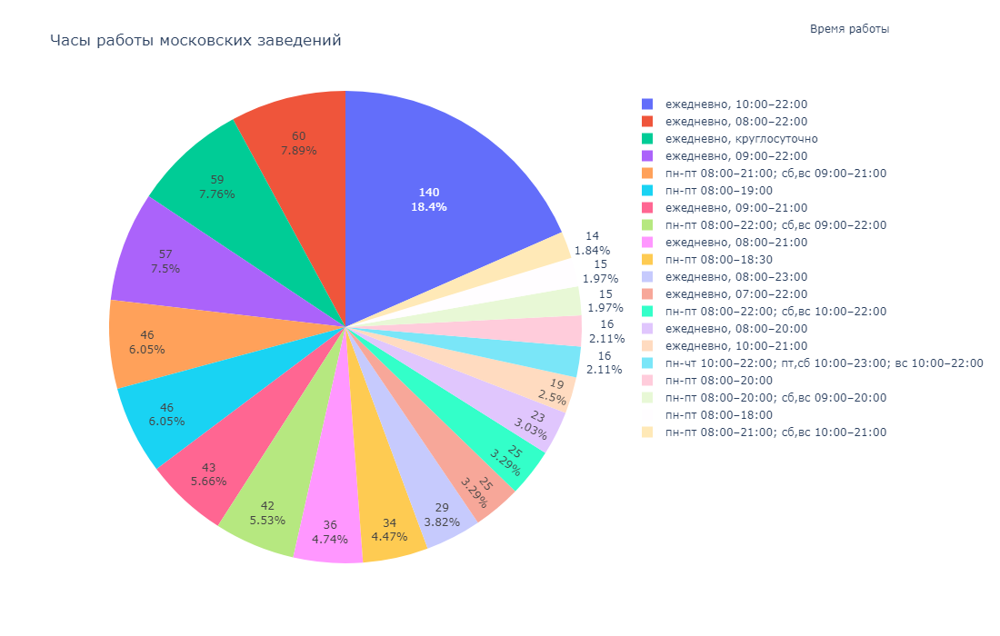

In [137]:
fig = go.Figure(data=[go.Pie(labels=cf_hrs['hours'], values=cf_hrs['name'])])
fig.update_layout(title='Часы работы московских заведений', 
                  width=1100, 
                  height=700,
                  annotations=[dict(x=1.50, 
                                    y=1.15,
                                    text='Время работы',
                                    showarrow=False)])
fig.update_traces(textinfo='percent+value')
fig.show("png")

Относительно большая доля кофеен работает ежедневно с 10 утра до 10 вечера. В то же время, отдельные заведения имеют разные часы работы в зависимости от того, будний день или выходной. Однако, в общем и целом, как минимум половина заведений общей выборки работает ежедневно.

### Рейтинги

Теперь детально рассмотрим картину рейтингов и их распределение в разрезе кофеен.

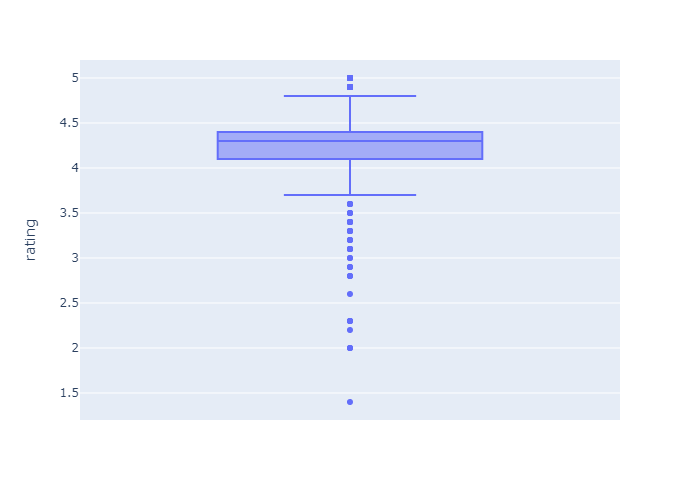

In [138]:
cf_rating = coffee[['name', 'rating']]

fig = px.box(cf_rating, y="rating")
fig.show("png")

Также отразим на карте распределение заведений по медианному рейтингу по округам Москвы. (Уже делалось в основном исследовании, поэтому повторимся для чистоты эксперимента)

In [139]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=coffee_rating_pivot,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг кофеен по районам',
).add_to(m)

m

Внимательно изучив полученные данные, можно сказать, что практически во всех районах Москвы кофейни стремятся к медианному рейтингу, и только в ЮЗАО их медианный рейтинг ниже. Поэтому, при прочих равных условиях, ЮЗАО стоит рассмотреть как округ для открытия крутой кофейни, как того хочет инвестор, поскольку публика, скорее всего, будет чаще ходить в кофейню значительно выше по качеству, чем остальные в округе.

### Стоимость чашки

Теперь изучим показатель "средней стоимости чашки капучино" в аналогичных нашему заведениях в Москве.

Построим диаграмму размаха, чтобы посмотреть, какие значения средней цены чашки капучино встречаются в нашей выборке.

Затем сделаем то же самое для среднего счета заведения.

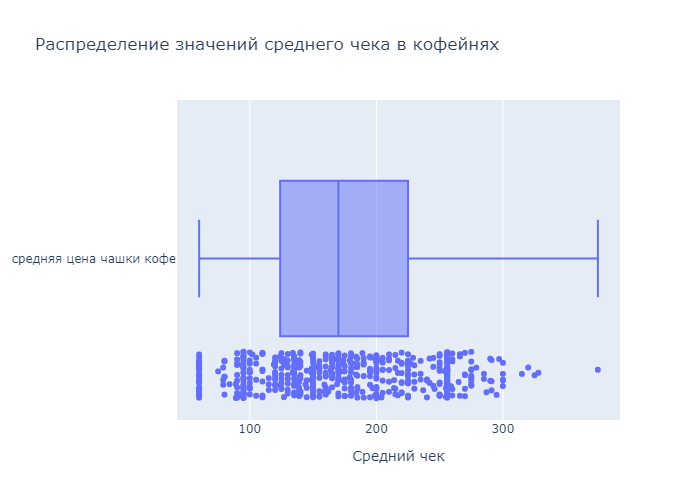

In [140]:
fig = go.Figure()
fig.add_trace(go.Box(x=coffee['middle_coffee_cup'], name='средняя цена чашки кофе', boxpoints='all'))
fig.update_layout(title="Распределение значений среднего чека в кофейнях",
                  xaxis_title="Средний чек")
fig.show("png")

В итоге получается весьма интересная картина: в большинстве кофеен средняя цена чашки капучино колеблется в пределах от 124 до 225 рублей, медианное значение - 170, минимальное - 60, а максимальное - 375. С учетом полученной информации можно выдать рекоменданию по определению ценового диапазона на чашку капучино в планируемой к открытию кофейне в районе 160 - 180 рублей, в зависимости от иных экономических факторов (арендной платы, места расположения и прочего).

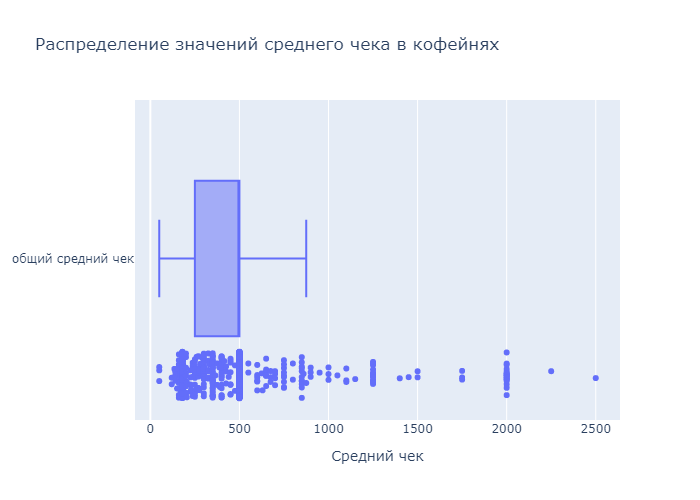

In [141]:
fig = go.Figure()

fig.add_trace(go.Box(x=coffee['middle_avg_bill'], name='общий средний чек', boxpoints='all'))
fig.update_layout(title="Распределение значений среднего чека в кофейнях",
                  xaxis_title="Средний чек")
fig.show("png")

В распределении данных по общему среднему чеку кофеен Москвы наблюдается интересная особенность: медиана совпадает с границей третьего квартиля. Поэтому можно с уверенностью заявить, что в большинстве московских кофеен средний чек составляет от 250 до 500 рублей, минимальный - 50, максимальный 875. И единичные выбросы в виде среднего чека величиной в 2500 рублей. Из полученной информации делаем вывод, что нашему заведению следует ориентироваться на показатель среднего чека в 500-600 рублей, чтобы быть местом, доступным если не каждому, то многим.

### Выводы

Имея на руках полученные графики и информацию, теперь мы можем сделать конечные выводы и дать рекомендации Заказчику о том, какие особенности нужно учесть при открытии желаемой им кофейни.

*1. Место расположения*

Наименее рейтинговые заведения находятся в ЮЗАО, поэтому основное внимание нужно сконцентрировать на данном районе. При детальном рассмотрении карты и точек расположения кофеен в городе, становится понятно, что станции метро - наиболее выгодные места для размещения заведения рассматриваемого типа. По карте видно, что в районе станции метро "Мичуринский проспект" и станции "Раменки" нет в шаговой доступности ни одной кофейни, при этом есть больница, несколько жилых комплексов и спальных районов. Одновременно с этим, Раменки в ЮЗАО, а значит здесь может быть запрос на появление крутого и качественного места, как этого желает Заказчик.

*2. Часы работы*

Большинство заведений работают ежедневно, но имеют различие во времени открытия и закрытия. Круглосуточных заведений в Москве на самом деле не так уж и много, и кофейни среди них - далеко не на первом месте, поскольку кофе и отход ко сну несовместимы как класс. Более того, в Москве большинство круглосуточных кофеен - заведения сетевые. Поэтому наша кофейня должна определенно быть не круглосуточной. 

Поэтому, с большой долей вероятности, следует обратить внимание на стандартные часы открытия и закрытия (с 10 утра до 10 вечера) и принимать окончательное решение после изучения, в том числе, пассажиропотока на ближайших станциях метро и остановках общественного транспорта.

*3. Средняя стоимость чашки и средний чек*

Среднюю стоимость чашки капучино следует рассматривать в диапазоне 160 - 180 рублей (не уходя далеко от медианного значения), в зависимости от стоимости аренды и окупаемости всей модели заведения, а средний чек рассматривать в диапазоне 500-600 рублей, снова в районе медианного значения.

Таким образом, итоговый "портрет" заведения для фонда "Shut Up and Take My Money" будет следующий: находящаяся в районе станций "Мичуринский проспект" и "Раменки" кофейня, работающая ежедневно с 10:00 до 22:00, имеющая среднюю стоимость чашки кофе от 160 до 180 рублей, и средний чек от 500 до 600 рублей.

*4. Количество посадочных мест*

Определив место расположения кофейни, можно также и определить типовое количество посадочных мест, характерное для заведений округа. В случае ЮЗАО, чаще всего местные кофейни имеют от 40 до 99 посадочных мест. Поэтому, для планируемого заведения будет рекомендоваться ориентироваться на данный диапазон.

На мой взгляд, такое заведение в указанном районе ждет определенный успех.

## Заключение

### Общее заключение

Мы изучили рынок заведений общественного питания в Москве как в общем смысле, так и в рамках конкретного задания Заказчика. 

Московский общепит интересен тем, что больше всего заведений всех типов сосредоточены в центре Москвы. У местных заведений самые высокие рейтинги и самые высокие средние чеки - вне зависимости от типа заведения.

При этом, расположение, количество и ценник каждого заведения, а также их распределение по районам города, полностью повторяют характерное для любого европейского города деление на East-end и West-end. Так и в Москве: ЮАО, ЮВАО, ВАО и СВАО - больше промзоны, и здесь живут люди с меньшим достатком, земля здесь также дешевле: и заведения здесь аналогичные, - более дешевые и менее рейтинговые. На востоке города и другое распределение заведений: здесь больше общепита и "простых" кафе. 

В то же время, на западе города больше ресторанов, баров. Также и рейтинги здесь немногим, но выше, и ценники больше. Но если изучать в разрезе каждого типа заведений, выходит, что в ЮЗАО менее качественные места, чем у "соседей".

В центре города же достаточно много заведений, которые являются единственными на своей улице: это обусловлено обилием небольших переулков в центре, а также высокой конкуренцией при размещении двух, допустим, разных заведений одного типа на одной улице.

Самыми же "нагруженными" заведениями улицами являются радиальные магистрали: как самые длинные, так и самые загруженные направления Москвы. Здесь постоянно активное движение автомобилей, и, соответственно, выше потенциальное количество клиентом, которые могут посетить заведение.

Круглосуточных заведений в городе не так уж и много, в сравнении с их общим количеством. При этом, как правило, они - сетевые, что говорит о том, что позволить себе работать без перерыва могут только те, кто экономит на масштабе.

Однако в общем и целом, сетевых заведений в городе всего треть, и большая их часть сосредоточена в заведениях, которые подают типовые блюда: пиццу, хлебобулочные изделия, кофе и т.п. 

Общий вывод же таков, что в Москве каждый ее район, каждая улица, формируют образ того, что в них и на них находится. Поэтому, с большой долей вероятности, красивый, необычный, дорогой ресторан будет в центре или на западе города, а дешевое низкорейтинговое кафе или фастфуд - на востоке.

### Частное заключение для инвестора

В рамках проведенного исследования было установлено, что идея открытия крутой и доступной, как «Central Perk» из сериала "Друзья", кофейни в Москве - вполне адекватная и может быть успешной.

Были даны рекомендации по местоположению, времени работы, ценовой политике и количеству посадочных мест заведения: район Раменки, недалеко от станций "Раменки" и "Мичуринский проспект"; работает ежедневно с 10:00 до 22:00; средняя стоимость капучино от 160 до 180 рублей, среднего чека - от 500 до 600 рублей; количество посадочных мест - от 40 до 99.

Такое заведение, при условии высокого уровня обслуживания, удачного расположения и качественной атмосферы, может быть действительно весьма успешным и окупить все вложенные в себя средства.